In [1]:
# %load_ext lab_black

## Imports

In [2]:
import os
from os.path import join
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from ast import literal_eval
import pickle


# Computer Vision
import cv2
from PIL import Image
import skimage.transform as st

# PDF Stuff
from pdf2image import convert_from_path
from PyPDF2 import PdfReader

from dla_pipeline_support_functions import (
    list_files_with_extensions,
    get_filename_without_extension,
    display_images_with_titles,
    generate_rectangular_mask,
    get_mask_bounding_box,
)

# Pandas display options
pd.set_option("display.max_rows", 999)
pd.set_option("display.max_columns", 999)
pd.set_option("display.width", 999)

In [3]:
# Root directory where all the model results are stored
DATA_DIRECTORY = "/user/w210/w210-dev-personal/discrete_model_tests/dit_pipeline/data/s4_dla_results/qasper_dev_DiT_DLA_Results_11-13-2023"

S1_INPUT_PDFS_DIR = join(DATA_DIRECTORY, "s1_input_pdfs")
S2_DLA_INPUTS_DIR = join(DATA_DIRECTORY, "s2_dla_inputs")
S3_OUTPUTS_DIR = join(DATA_DIRECTORY, "s3_outputs")

MODEL_OUTPUTS_DIR = join(S3_OUTPUTS_DIR, "model_outputs")
PAGE_MASKS_DIR = join(S3_OUTPUTS_DIR, "page_masks")

assert os.path.exists(S1_INPUT_PDFS_DIR)
assert os.path.exists(MODEL_OUTPUTS_DIR)
assert os.path.exists(PAGE_MASKS_DIR)

## Support Functions

In [4]:
# Debug, to ensure that the the contents on the individual csvs match the registry one
def valadiate_results_csvs(page_mask_directory):
    try:
        agg_csvs = pd.DataFrame()

        for file in list_files_with_extensions(page_mask_directory, ["csv"]):
            file_name = get_filename_without_extension(file)

            if file_name == "mask_registry":
                mask_registry = pd.read_csv(file)

            else:
                agg_csvs = pd.concat([agg_csvs, pd.read_csv(file)], axis=0)

        agg_csvs.drop("Unnamed: 0", axis=1, inplace=True)
        mask_registry.drop("Unnamed: 0", axis=1, inplace=True)

        agg_csvs.sort_values(["document", "page_no", "mask_id"], inplace=True)
        mask_registry.sort_values(["document", "page_no", "mask_id"], inplace=True)

        # Check that they are the same
        assert len(mask_registry) == len(
            agg_csvs
        ), "The aggregated content of all the individual page csvs and the mask_registry, do not have the same length"
        assert np.array_equal(
            agg_csvs, mask_registry
        ), "The aggregated content of all the individual page csvs and the mask_registry, do not match"

    except Exception as e:
        raise Exception(f"Match error: {e}")


def load_mask_registry(page_mask_directory, validate_csvs=False):
    valadiate_results_csvs(page_mask_directory)
    mask_registry = pd.read_csv(join(page_mask_directory, "mask_registry.csv"))

    mask_registry.sort_values(["document", "page_no", "mask_id"], inplace=True)

    mask_registry = mask_registry[
        [
            "document",
            "page_no",
            "mask_id",
            "category",
            "category_lbl",
            "score",
            "x0",
            "x1",
            "y0",
            "y1",
            "xcf",
            "ycf",
            "column",
            "mask_shape",
            "is_primary",
            "mask_img_file_names",
            "mask_file_names",
        ]
    ]

    mask_registry["mask_shape"] = mask_registry["mask_shape"].apply(
        lambda var: literal_eval(var)
    )

    return mask_registry

## Read Mask Registry

In [5]:
mask_registry = load_mask_registry(PAGE_MASKS_DIR, validate_csvs=False)
document_list = np.unique(mask_registry["document"].values)

print(f"Total number documents: {len(document_list)}")

Total number documents: 280


## Display exisiting page images

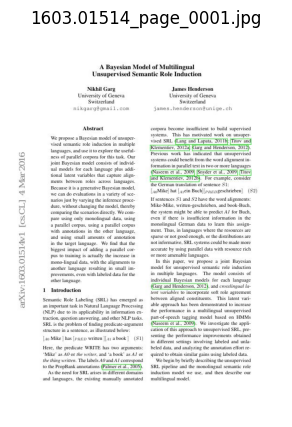

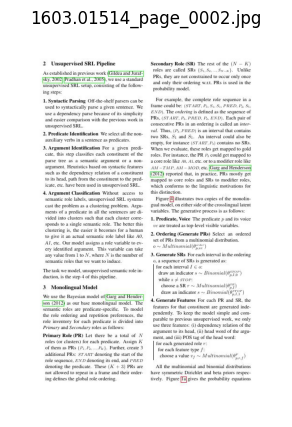

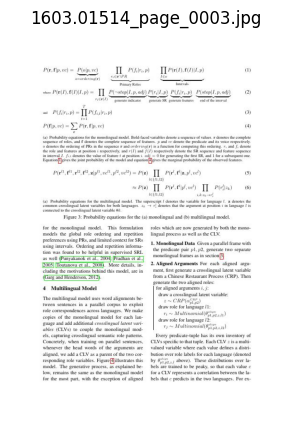

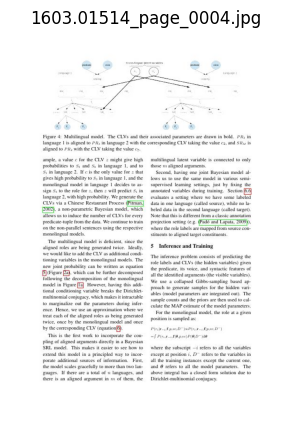

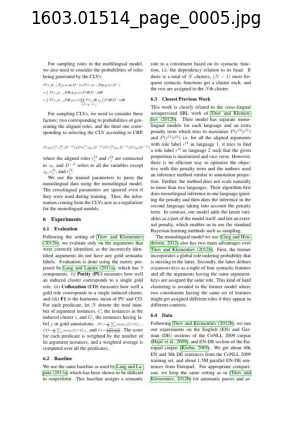

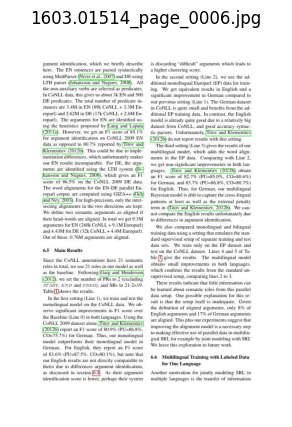

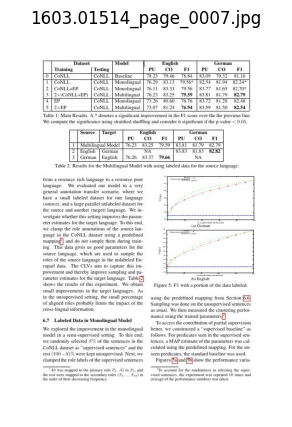

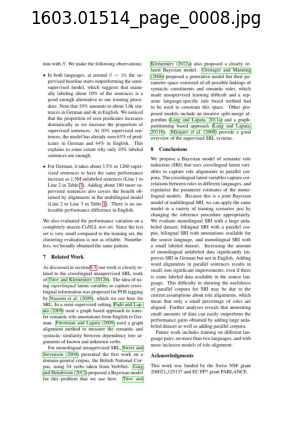

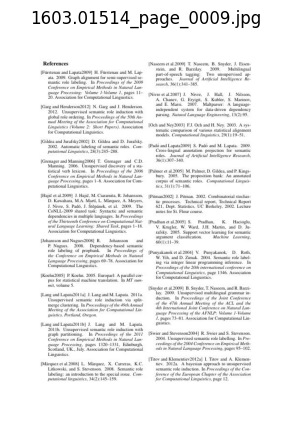

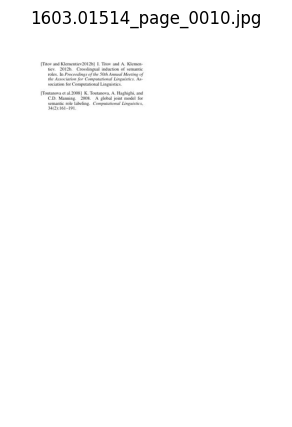

In [6]:
doc_idx = 2

document_file = document_list[doc_idx]
document_name = get_filename_without_extension(document_file)
document_path = join(S1_INPUT_PDFS_DIR, document_file)
document_pdf = PdfReader(document_path)
document_page_count = len(document_pdf.pages)

for i in range(document_page_count):
    page_no = i + 1

    image_file = f"{document_name}_page_{page_no:04}.jpg"
    image_path = join(S2_DLA_INPUTS_DIR, image_file)

    if os.path.exists(image_path):
        page_img = plt.imread(image_path)
        plt.figure(figsize=(4, 5))
        plt.imshow(page_img)
        plt.axis("off")  # Hide axis labels and ticks
        plt.title(image_file)  # Set the title for each subplot
        plt.show()
    else:
        print(f"Cannot find {image_path}")

## Display DLA Model Results Images

page: 1


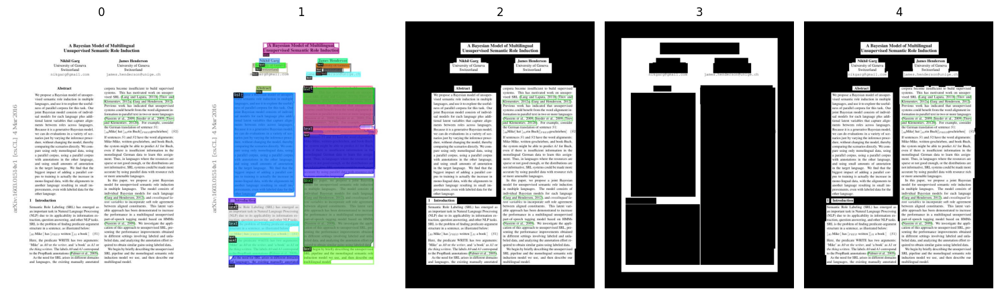

page: 2


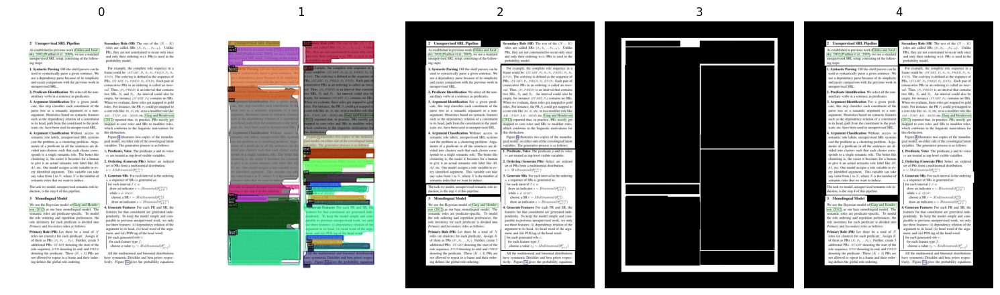

page: 3


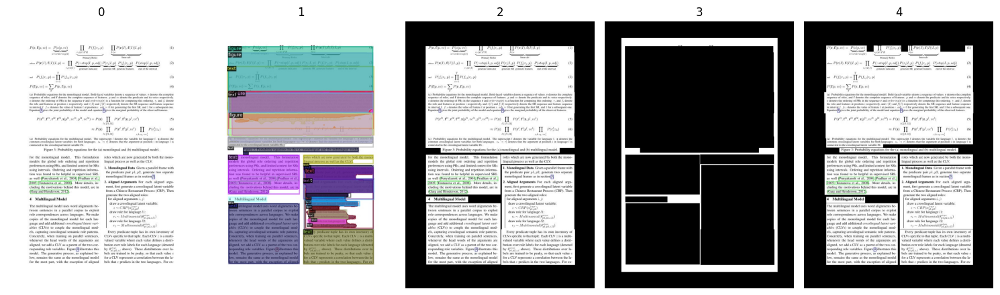

page: 4


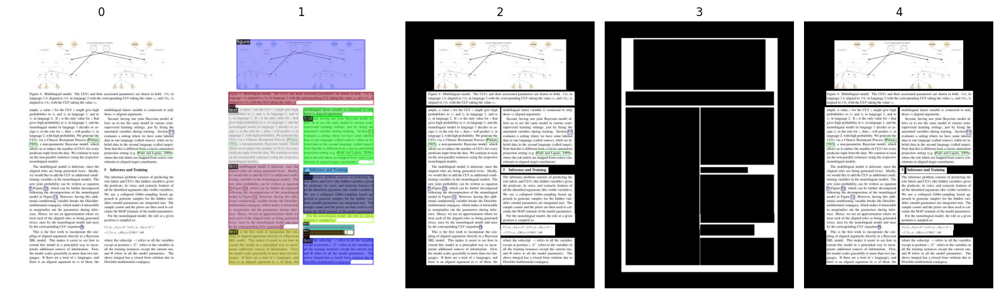

page: 5


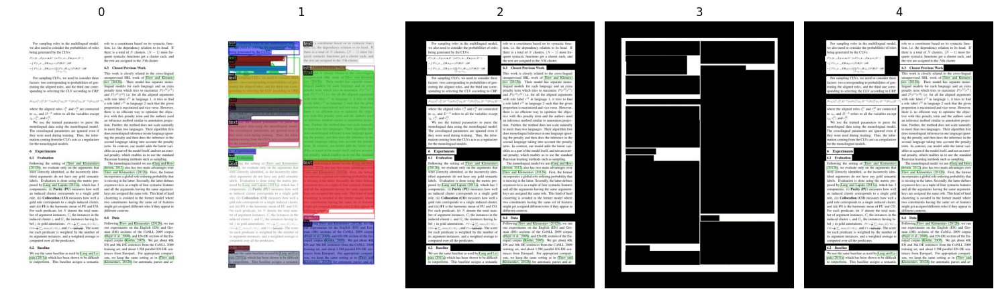

page: 6


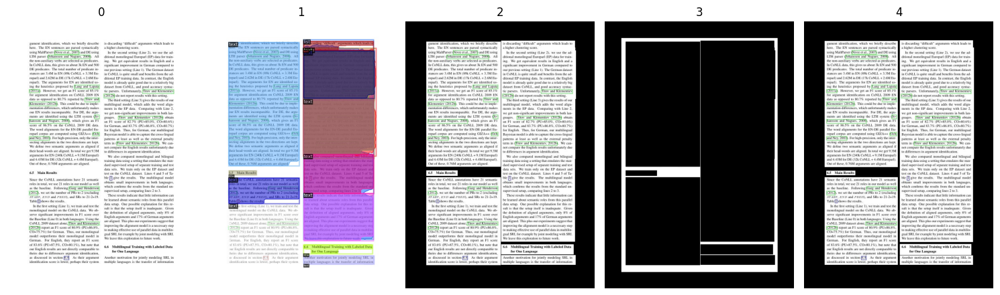

page: 7


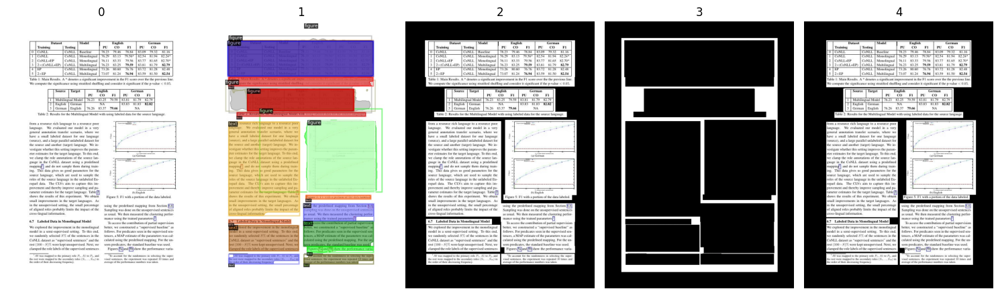

page: 8


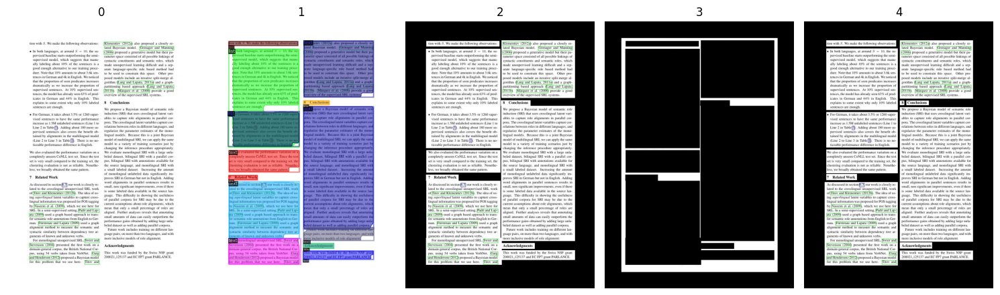

page: 9


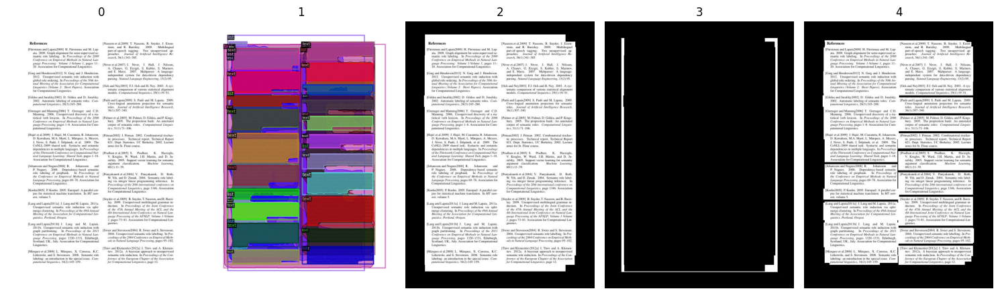

page: 10


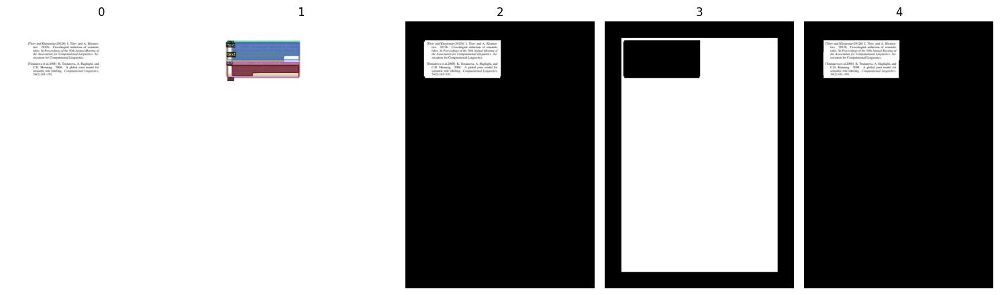

In [7]:
doc_idx = 2

document_file = document_list[doc_idx]
document_name = get_filename_without_extension(document_file)
document_path = join(S1_INPUT_PDFS_DIR, document_file)
document_pdf = PdfReader(document_path)
document_page_count = len(document_pdf.pages)

model_result_images = list_files_with_extensions(MODEL_OUTPUTS_DIR, ["jpg"])

for i in range(document_page_count):
    page_no = i + 1

    print(f"page: {page_no}")

    image_root = f"{document_name}_page_{page_no:04}_"
    images = [plt.imread(path) for path in model_result_images if image_root in path]

    display_images_with_titles(images, figsize=(15, 30))

## Apply masks on newly generated page images (Base Resolution of 70 dpi)

In [8]:
BASE_DPI = 70

In [9]:
doc_idx = 2
page_no = 4

document_file = document_list[doc_idx]
document_name = get_filename_without_extension(document_file)
document_path = join(S1_INPUT_PDFS_DIR, document_file)
document_pdf = PdfReader(document_path)
document_page_count = len(document_pdf.pages)

# Generate page images
page_images = [np.array(img) for img in convert_from_path(document_path, dpi=BASE_DPI)]

# Create a filtered dataframe for the document and page

page_idx = page_no - 1
query = f"document=='{document_file}' & page_no=={page_no} & is_primary == True"
doc_registry = mask_registry.query(query)

display(doc_registry)

,document,page_no,mask_id,category,category_lbl,score,x0,x1,y0,y1,xcf,ycf,column,mask_shape,is_primary,mask_img_file_names,mask_file_names
38383,1603.01514.pdf,4,0,5,figure,0.998022,91,488,56,208,289.5,132.0,0,"(819, 579)",True,1603.01514_page_0004_mask_img_0.jpg,1603.01514_page_0004_mask_0.pkl
38384,1603.01514.pdf,4,1,1,text,0.995385,66,518,211,258,292.0,234.5,0,"(819, 579)",True,1603.01514_page_0004_mask_img_1.jpg,1603.01514_page_0004_mask_1.pkl
38385,1603.01514.pdf,4,2,1,text,0.998975,61,288,261,440,174.5,350.5,0,"(819, 579)",True,1603.01514_page_0004_mask_img_2.jpg,1603.01514_page_0004_mask_2.pkl
38386,1603.01514.pdf,4,3,1,text,0.999385,61,288,436,642,174.5,539.0,0,"(819, 579)",True,1603.01514_page_0004_mask_img_3.jpg,1603.01514_page_0004_mask_3.pkl
38387,1603.01514.pdf,4,4,1,text,0.999284,66,288,636,748,177.0,692.0,0,"(819, 579)",True,1603.01514_page_0004_mask_img_4.jpg,1603.01514_page_0004_mask_4.pkl
38388,1603.01514.pdf,4,5,1,text,0.995181,291,518,261,294,404.5,277.5,1,"(819, 579)",True,1603.01514_page_0004_mask_img_5.jpg,1603.01514_page_0004_mask_5.pkl
38389,1603.01514.pdf,4,6,1,text,0.998657,291,518,287,443,404.5,365.0,1,"(819, 579)",True,1603.01514_page_0004_mask_img_6.jpg,1603.01514_page_0004_mask_6.pkl
38390,1603.01514.pdf,4,7,2,title,0.992081,291,438,446,468,364.5,457.0,1,"(819, 579)",True,1603.01514_page_0004_mask_img_7.jpg,1603.01514_page_0004_mask_7.pkl
38391,1603.01514.pdf,4,8,1,text,0.997251,291,518,466,593,404.5,529.5,1,"(819, 579)",True,1603.01514_page_0004_mask_img_8.jpg,1603.01514_page_0004_mask_8.pkl
38392,1603.01514.pdf,4,9,1,text,0.979492,291,518,587,621,404.5,604.0,1,"(819, 579)",True,1603.01514_page_0004_mask_img_9.jpg,1603.01514_page_0004_mask_9.pkl


### Directly apply a rectangular mask based on the image corners

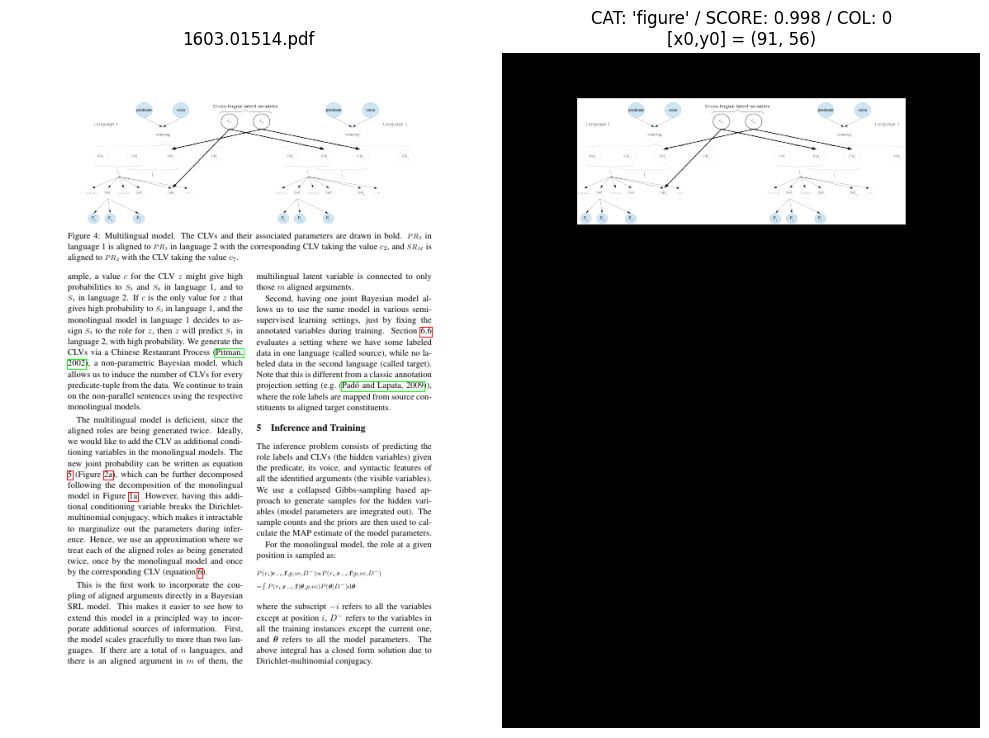

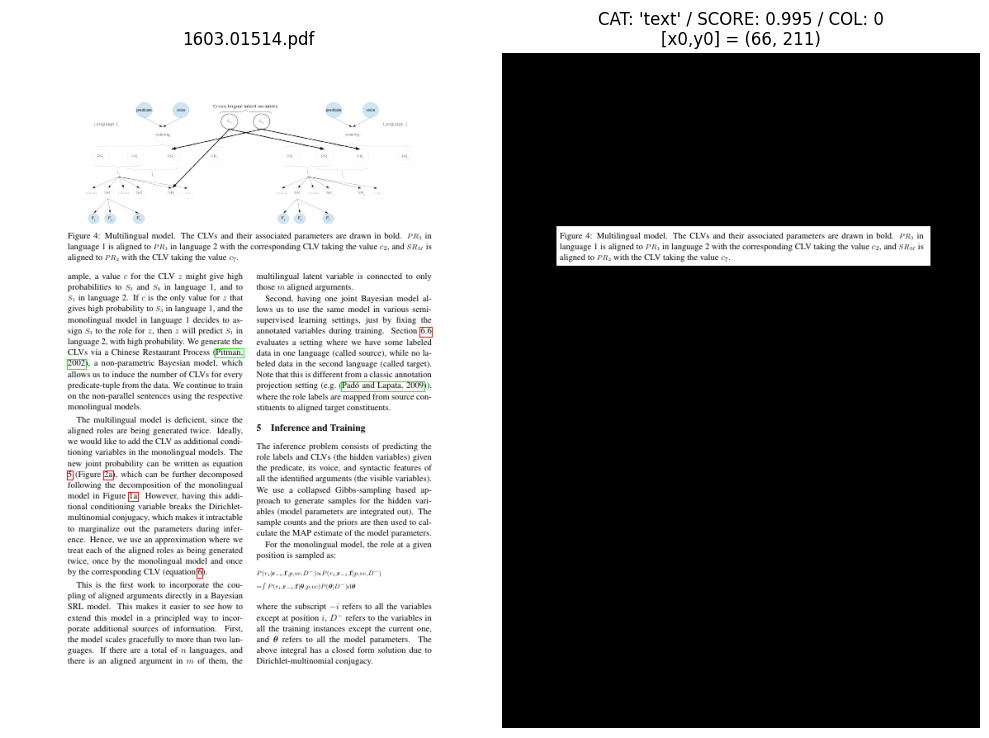

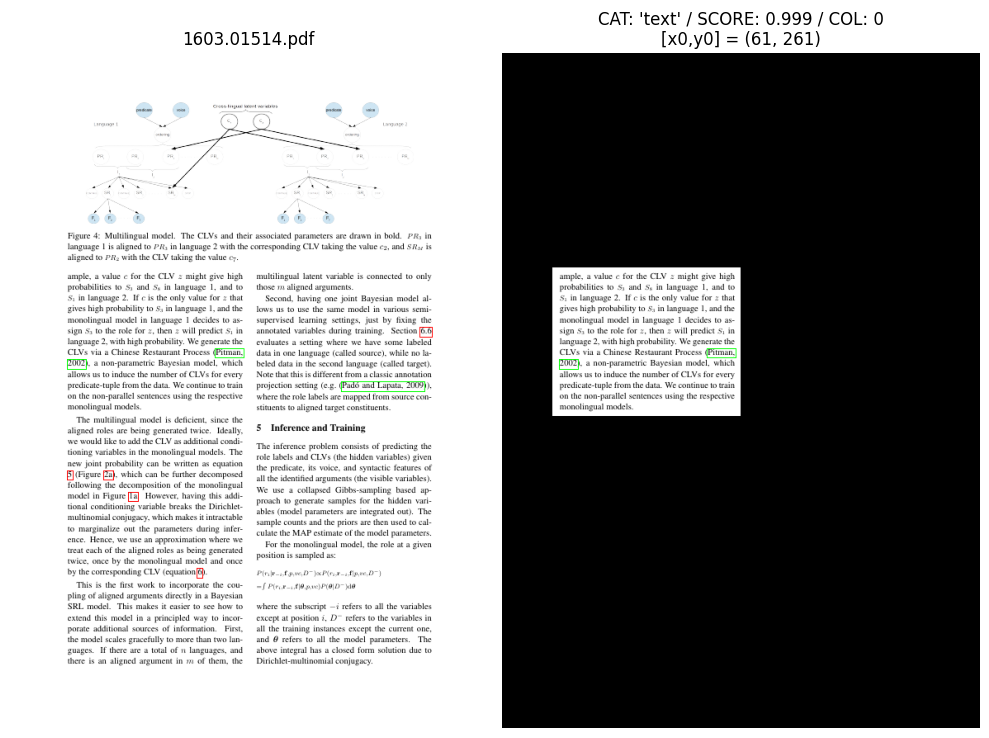

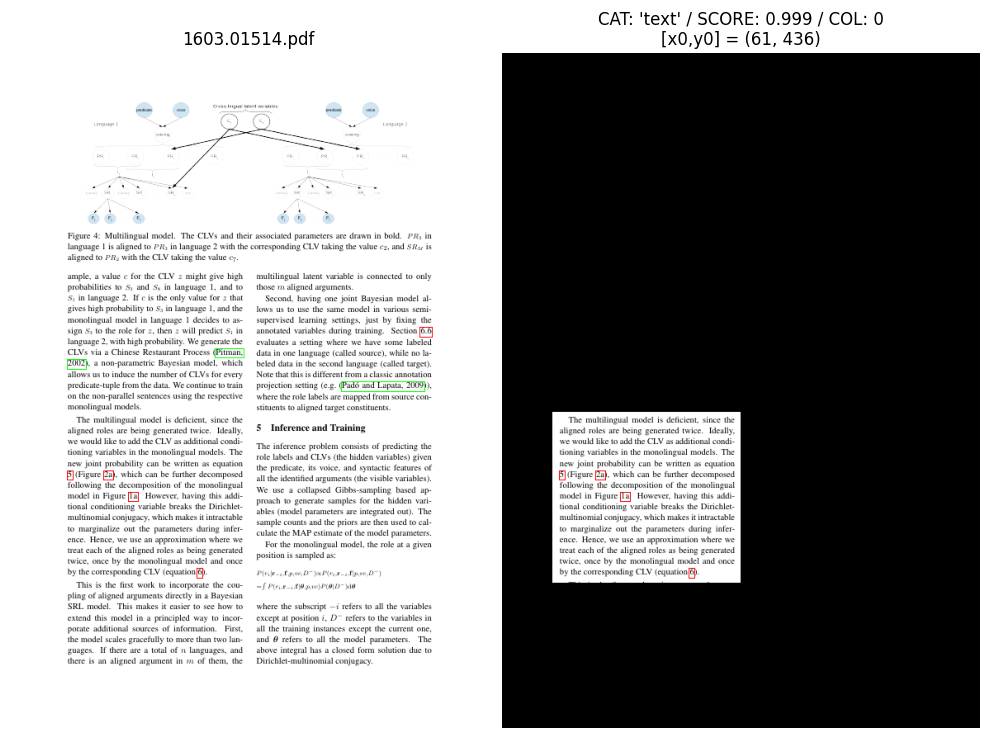

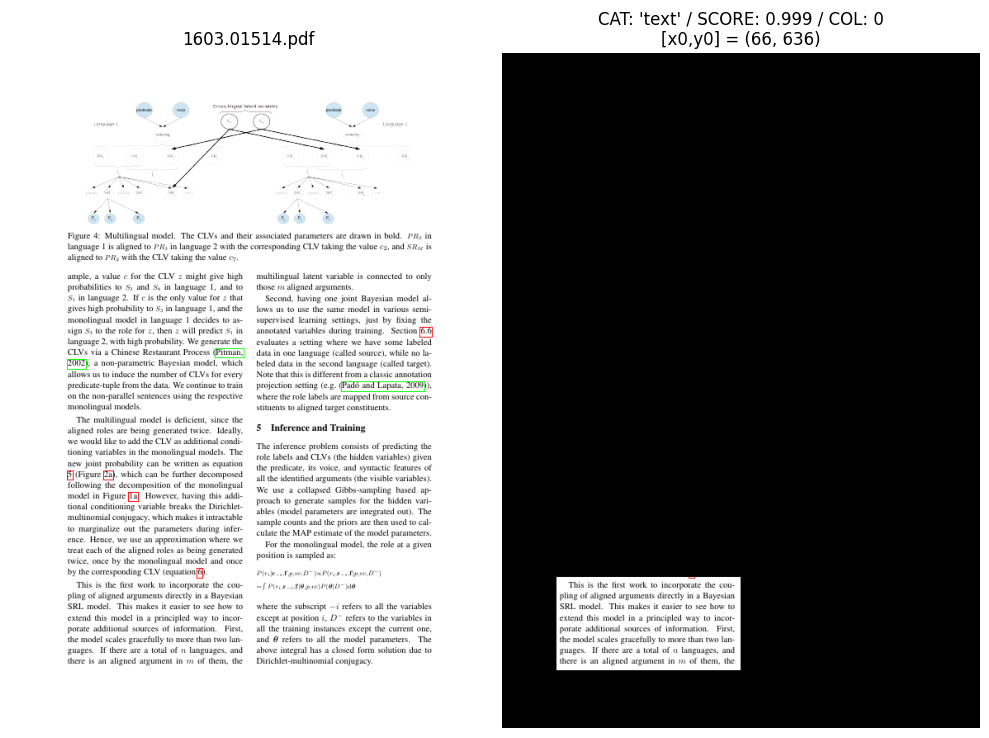

...

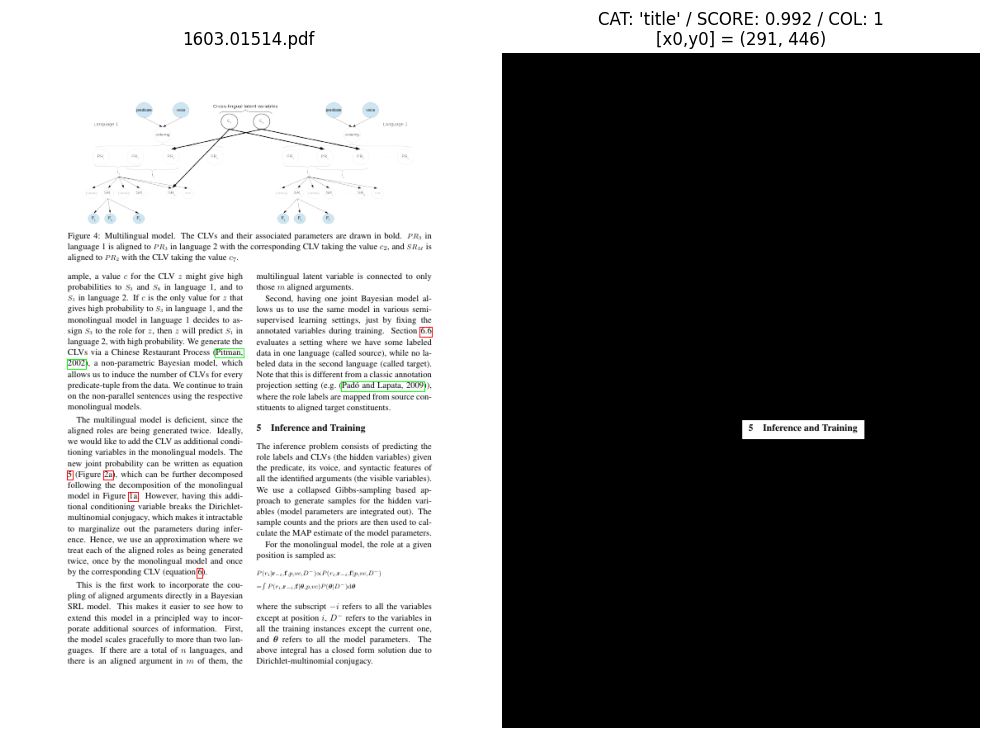

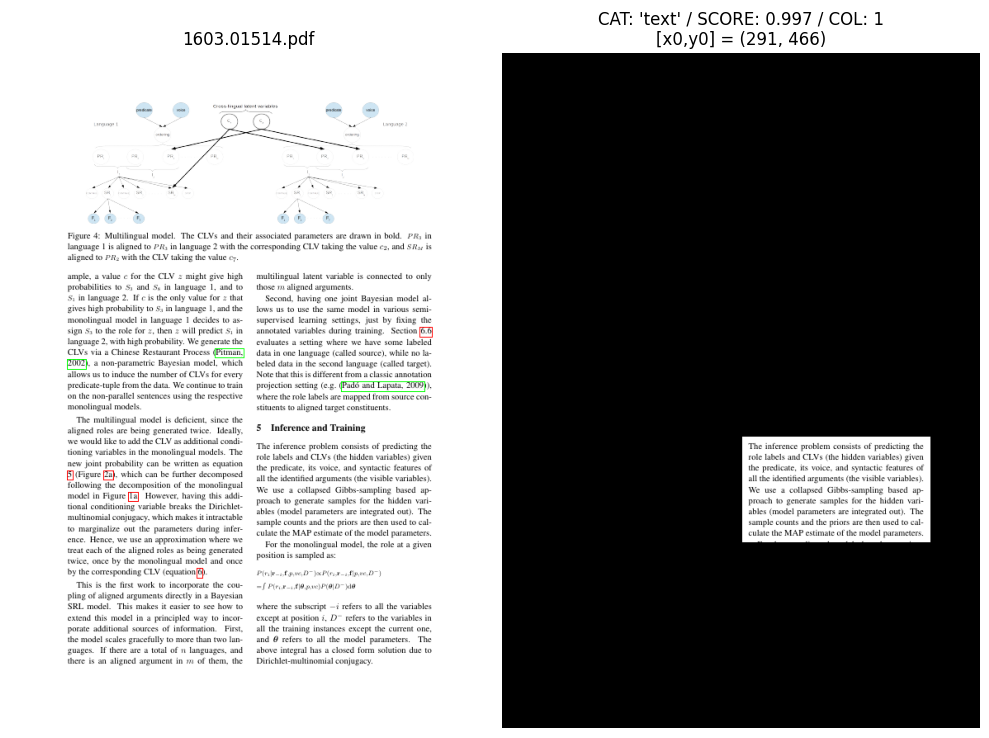

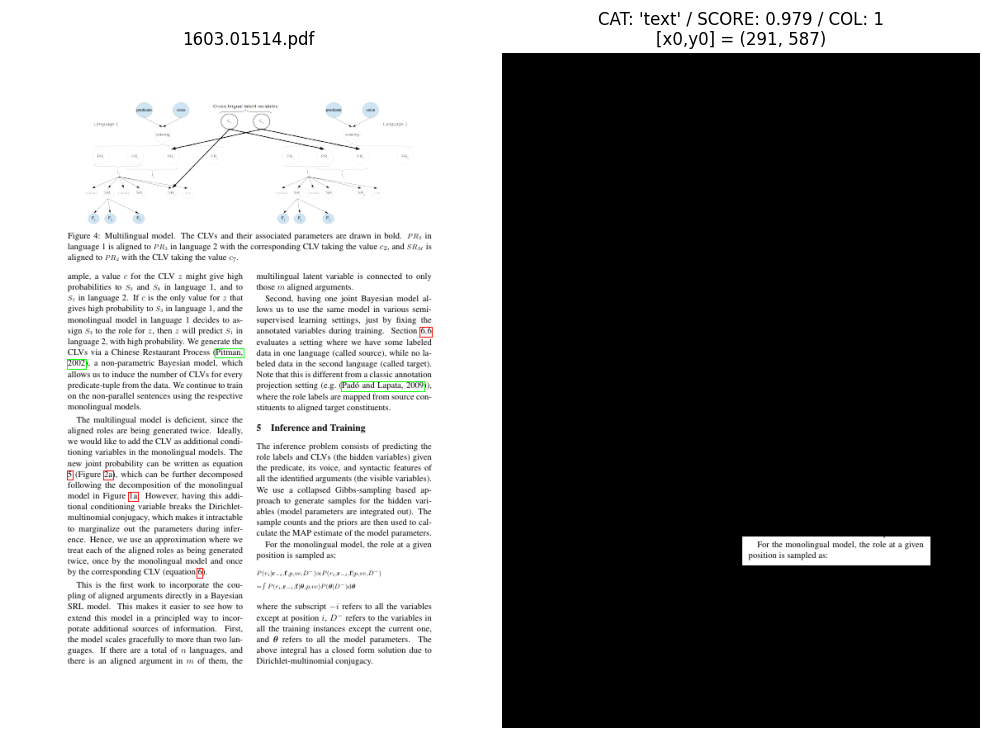

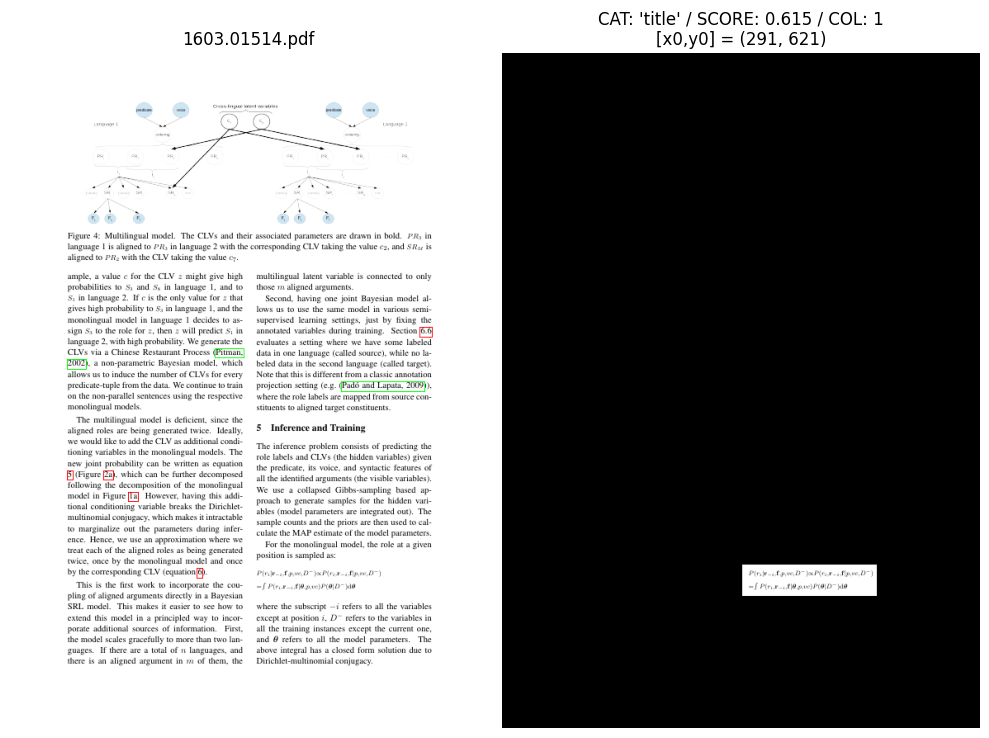

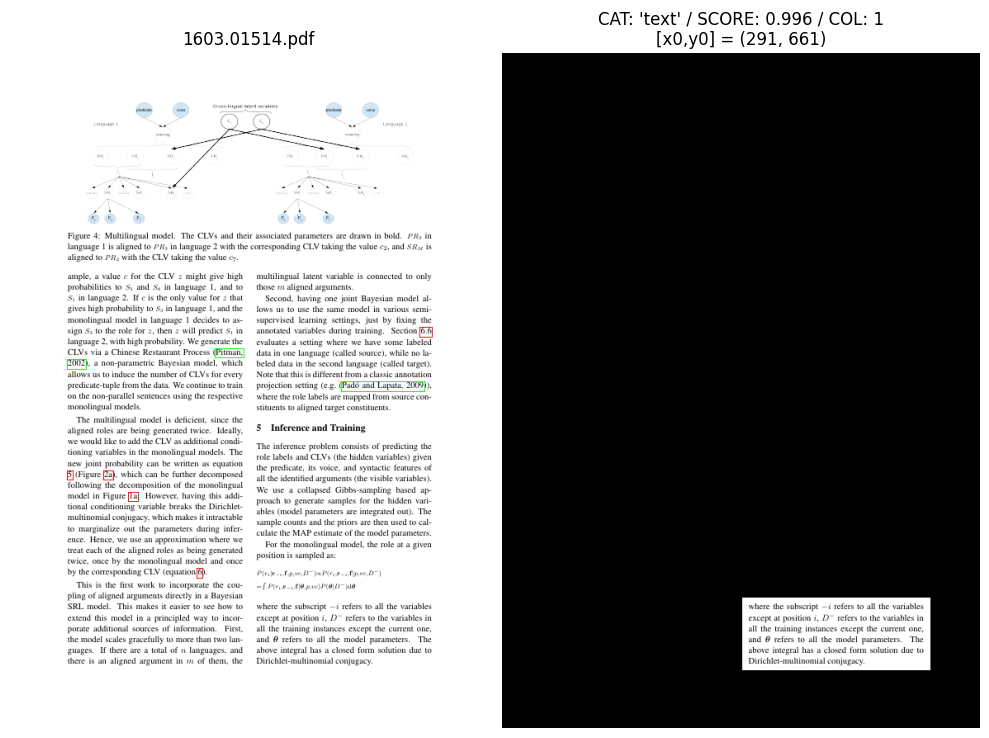

In [10]:
for i in range(len(doc_registry)):
    #

    row = doc_registry.iloc[i, :]

    x0 = row["x0"]
    x1 = row["x1"]
    y0 = row["y0"]
    y1 = row["y1"]
    mask_shape = row["mask_shape"]

    mask = generate_rectangular_mask(x0, x1, y0, y1, mask_shape)

    page_img = page_images[page_idx]
    masked_img = cv2.bitwise_and(page_img, page_img, mask=mask)
    mask_title = f"CAT: '{row['category_lbl']}' / SCORE: {row['score']:0.3f} / COL: {row['column']}\n[x0,y0] = {(x0,y0)}"

    titles = [document_file, mask_title]

    display_images_with_titles([page_img, masked_img], titles)

### Directly apply a loaded `pkl` mask to an image

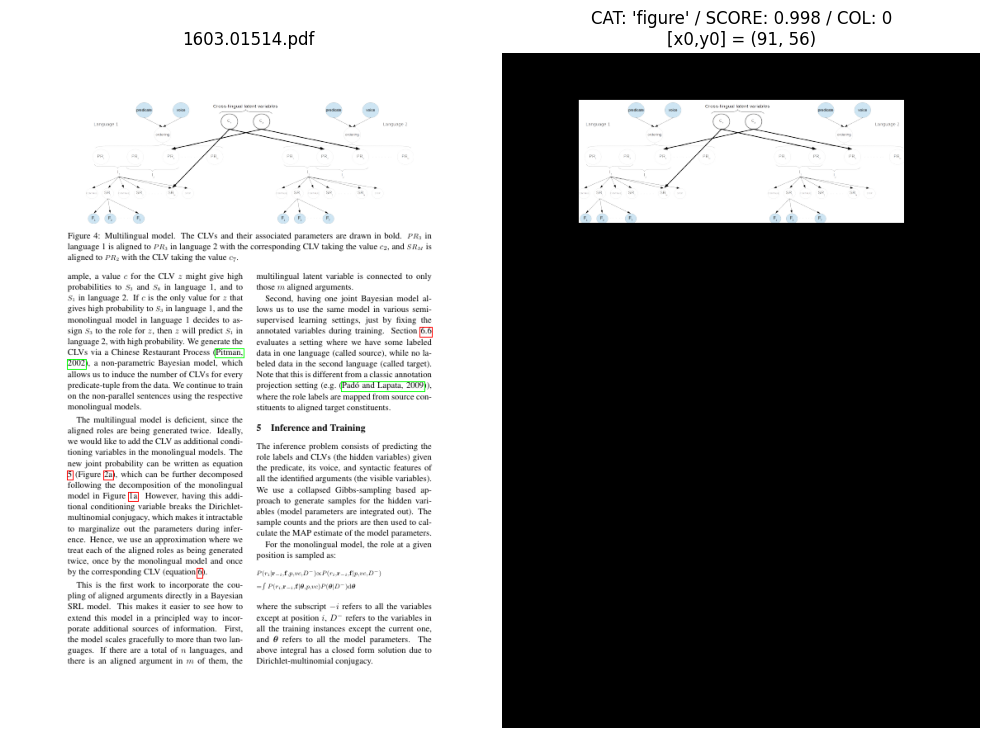

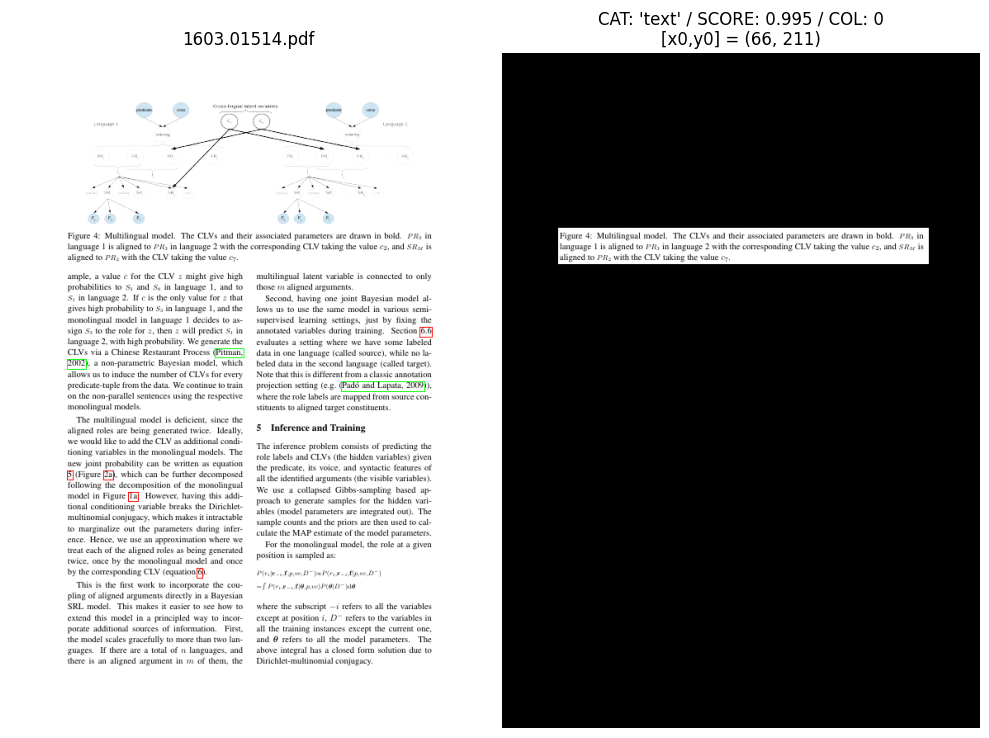

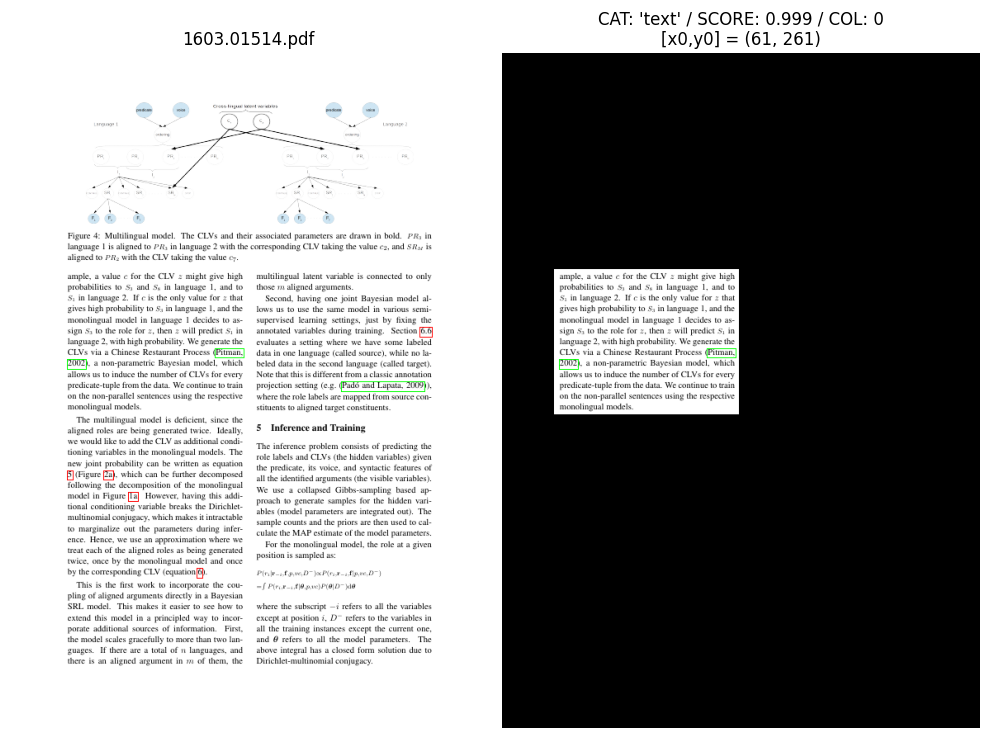

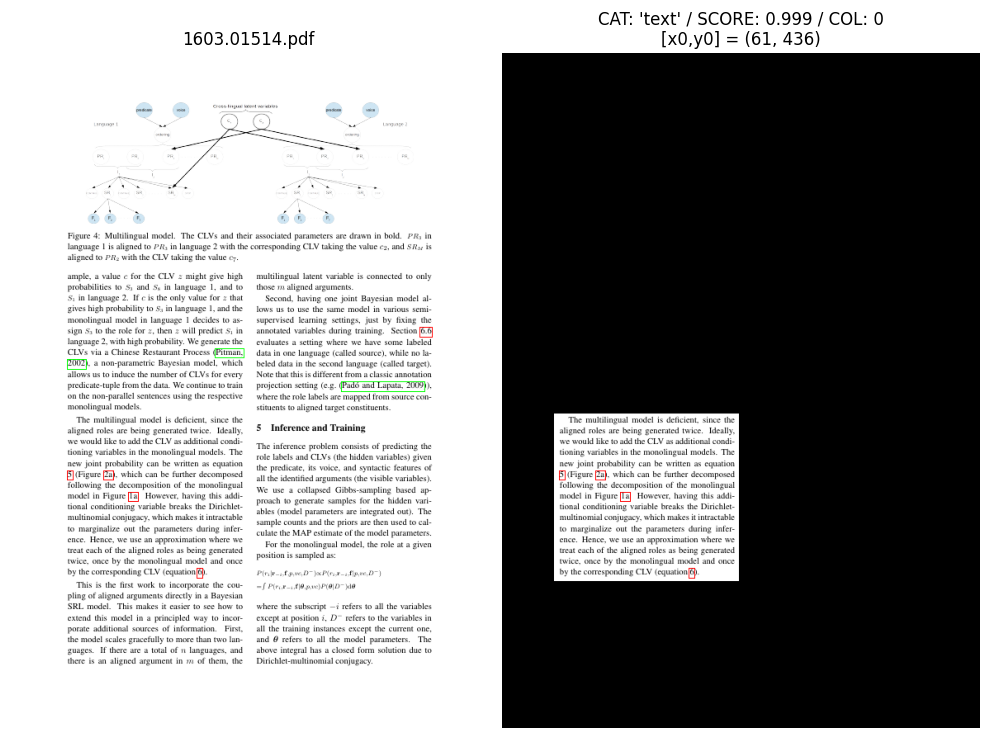

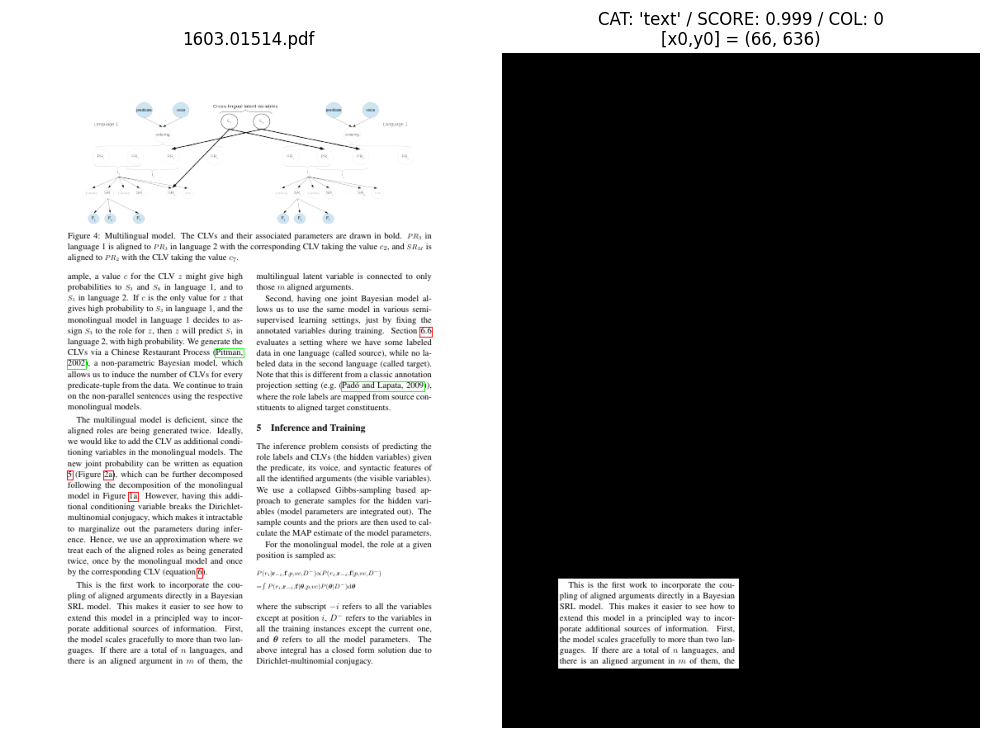

...

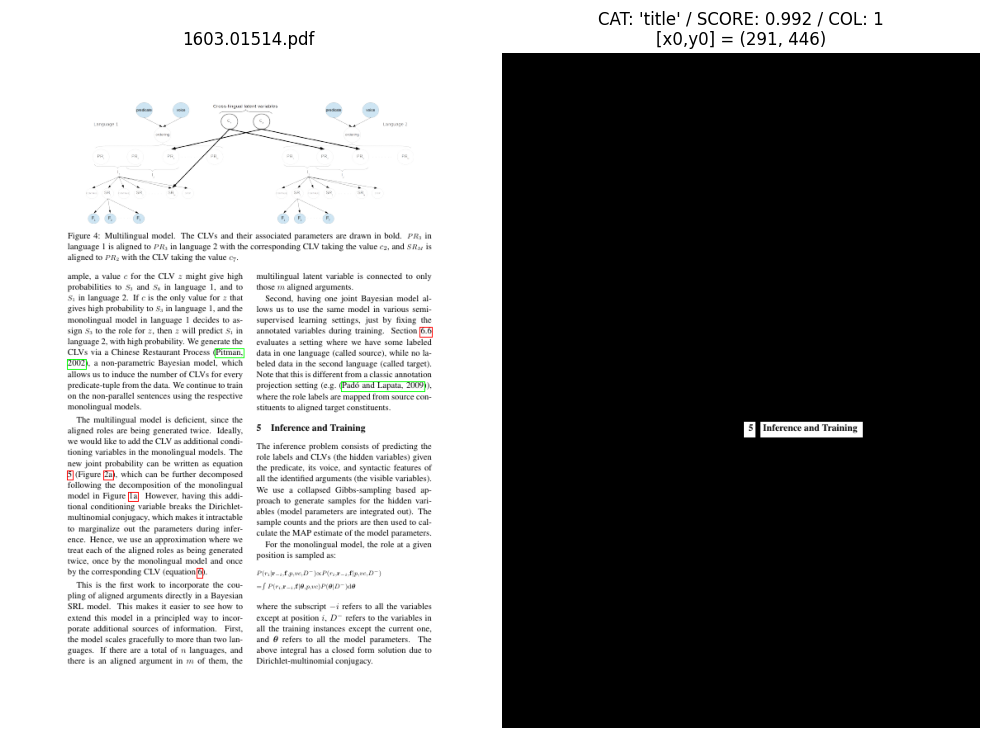

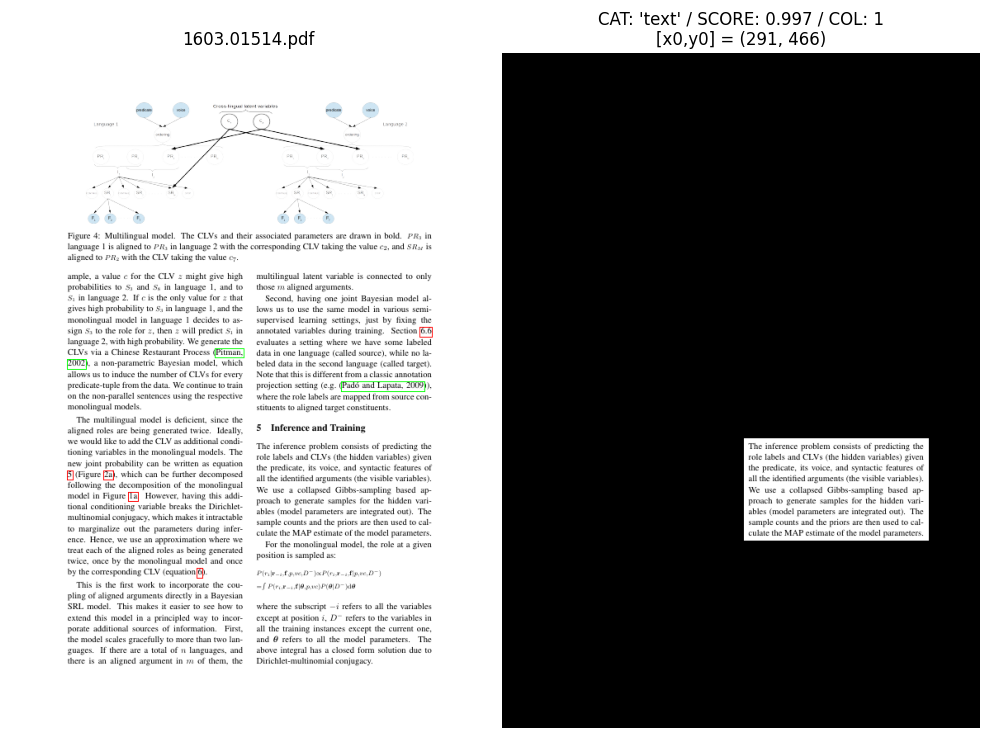

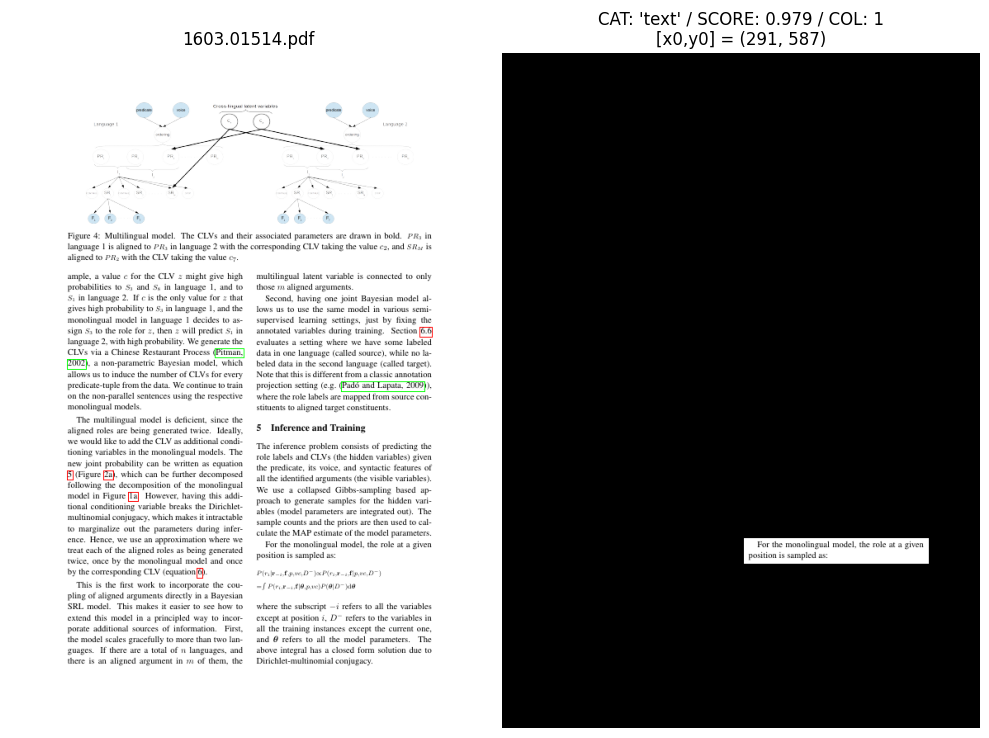

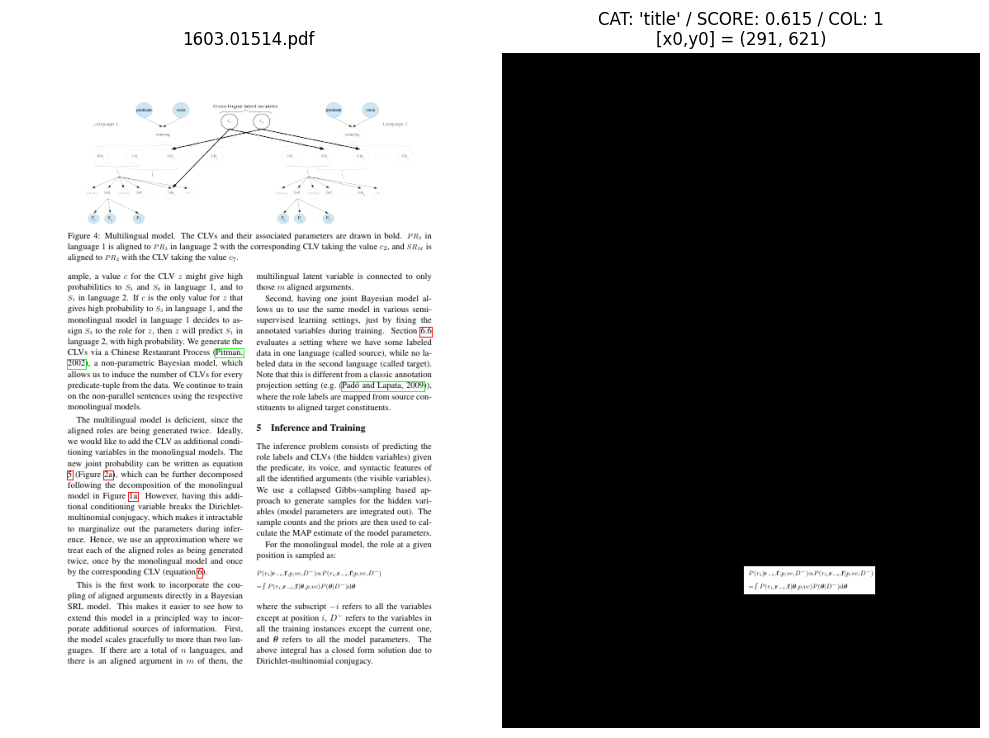

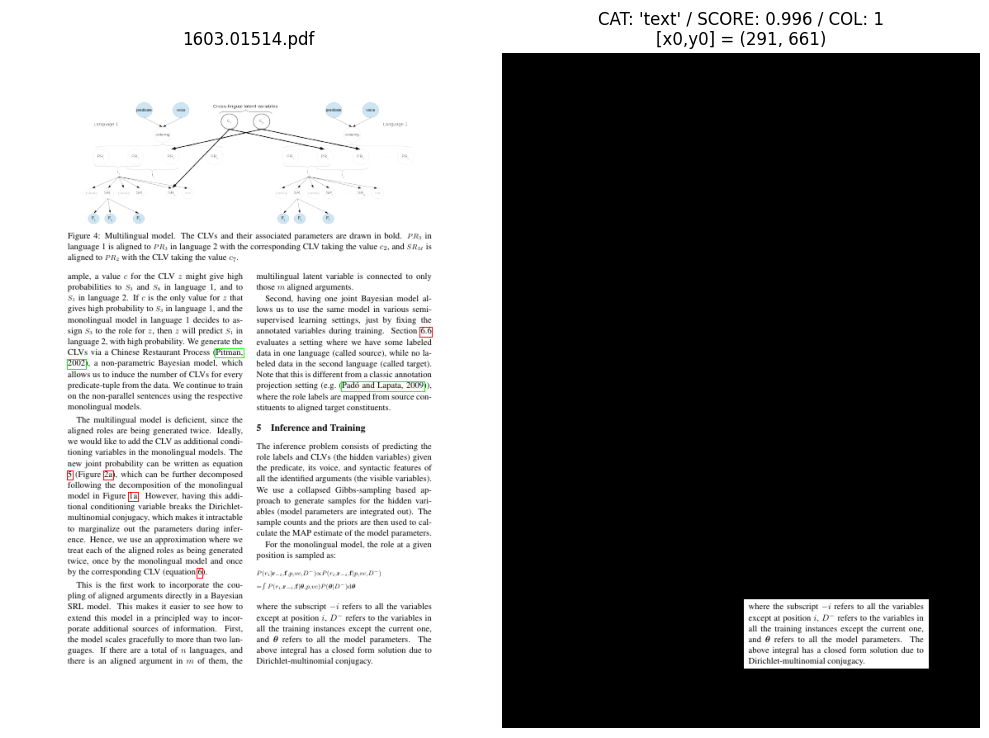

In [11]:
for i in range(len(doc_registry)):
    row = doc_registry.iloc[i, :]

    x0 = row["x0"]
    x1 = row["x1"]
    y0 = row["y0"]
    y1 = row["y1"]
    mask_shape = row["mask_shape"]
    pkl_path = join(PAGE_MASKS_DIR, row["mask_file_names"])

    with open(pkl_path, "rb") as file:
        mask = pickle.load(file)

    page_img = page_images[page_idx]
    masked_img = cv2.bitwise_and(page_img, page_img, mask=mask)
    mask_title = f"CAT: '{row['category_lbl']}' / SCORE: {row['score']:0.3f} / COL: {row['column']}\n[x0,y0] = {(x0,y0)}"

    titles = [document_file, mask_title]

    display_images_with_titles([page_img, masked_img], titles)

## Apply RESCALED masks on newly generated page images (at @ 140 dpi )

In [12]:
BASE_DPI = 140

In [13]:
doc_idx = 2
page_no = 4

document_file = document_list[doc_idx]
document_name = get_filename_without_extension(document_file)
document_path = join(S1_INPUT_PDFS_DIR, document_file)
document_pdf = PdfReader(document_path)
document_page_count = len(document_pdf.pages)

# Generate page images
page_images = [np.array(img) for img in convert_from_path(document_path, dpi=BASE_DPI)]

# Create a filtered dataframe for the document and page

page_idx = page_no - 1
query = f"document=='{document_file}' & page_no=={page_no} & is_primary == True"
doc_registry = mask_registry.query(query)

display(doc_registry)

,document,page_no,mask_id,category,category_lbl,score,x0,x1,y0,y1,xcf,ycf,column,mask_shape,is_primary,mask_img_file_names,mask_file_names
38383,1603.01514.pdf,4,0,5,figure,0.998022,91,488,56,208,289.5,132.0,0,"(819, 579)",True,1603.01514_page_0004_mask_img_0.jpg,1603.01514_page_0004_mask_0.pkl
38384,1603.01514.pdf,4,1,1,text,0.995385,66,518,211,258,292.0,234.5,0,"(819, 579)",True,1603.01514_page_0004_mask_img_1.jpg,1603.01514_page_0004_mask_1.pkl
38385,1603.01514.pdf,4,2,1,text,0.998975,61,288,261,440,174.5,350.5,0,"(819, 579)",True,1603.01514_page_0004_mask_img_2.jpg,1603.01514_page_0004_mask_2.pkl
38386,1603.01514.pdf,4,3,1,text,0.999385,61,288,436,642,174.5,539.0,0,"(819, 579)",True,1603.01514_page_0004_mask_img_3.jpg,1603.01514_page_0004_mask_3.pkl
38387,1603.01514.pdf,4,4,1,text,0.999284,66,288,636,748,177.0,692.0,0,"(819, 579)",True,1603.01514_page_0004_mask_img_4.jpg,1603.01514_page_0004_mask_4.pkl
38388,1603.01514.pdf,4,5,1,text,0.995181,291,518,261,294,404.5,277.5,1,"(819, 579)",True,1603.01514_page_0004_mask_img_5.jpg,1603.01514_page_0004_mask_5.pkl
38389,1603.01514.pdf,4,6,1,text,0.998657,291,518,287,443,404.5,365.0,1,"(819, 579)",True,1603.01514_page_0004_mask_img_6.jpg,1603.01514_page_0004_mask_6.pkl
38390,1603.01514.pdf,4,7,2,title,0.992081,291,438,446,468,364.5,457.0,1,"(819, 579)",True,1603.01514_page_0004_mask_img_7.jpg,1603.01514_page_0004_mask_7.pkl
38391,1603.01514.pdf,4,8,1,text,0.997251,291,518,466,593,404.5,529.5,1,"(819, 579)",True,1603.01514_page_0004_mask_img_8.jpg,1603.01514_page_0004_mask_8.pkl
38392,1603.01514.pdf,4,9,1,text,0.979492,291,518,587,621,404.5,604.0,1,"(819, 579)",True,1603.01514_page_0004_mask_img_9.jpg,1603.01514_page_0004_mask_9.pkl


### Directly apply a RESCALED rectangular mask based on the image corners

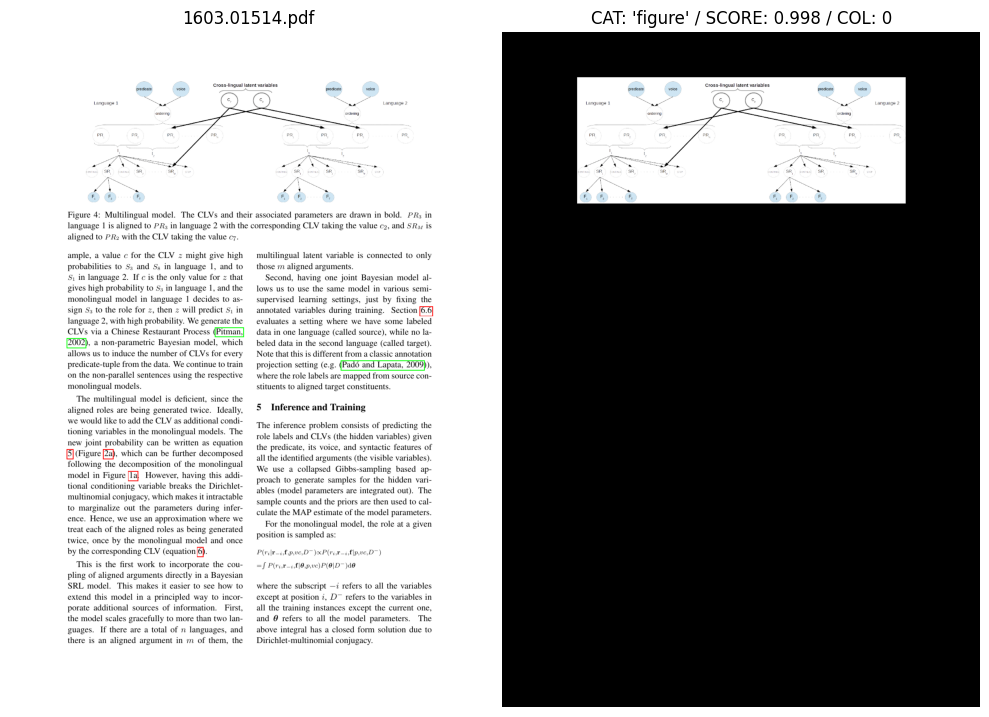

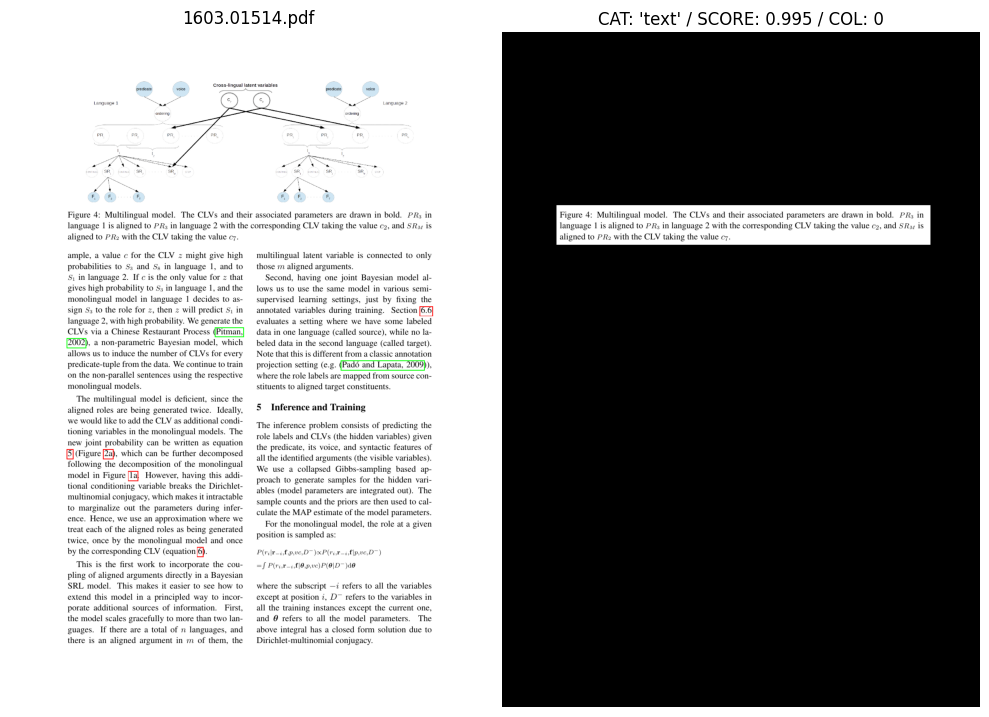

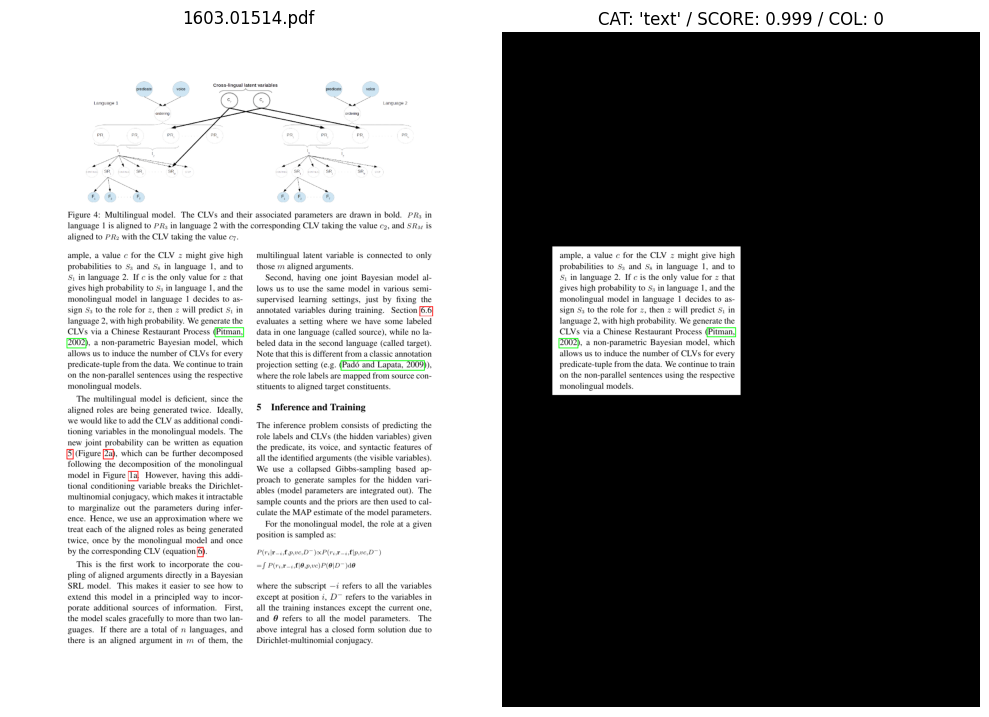

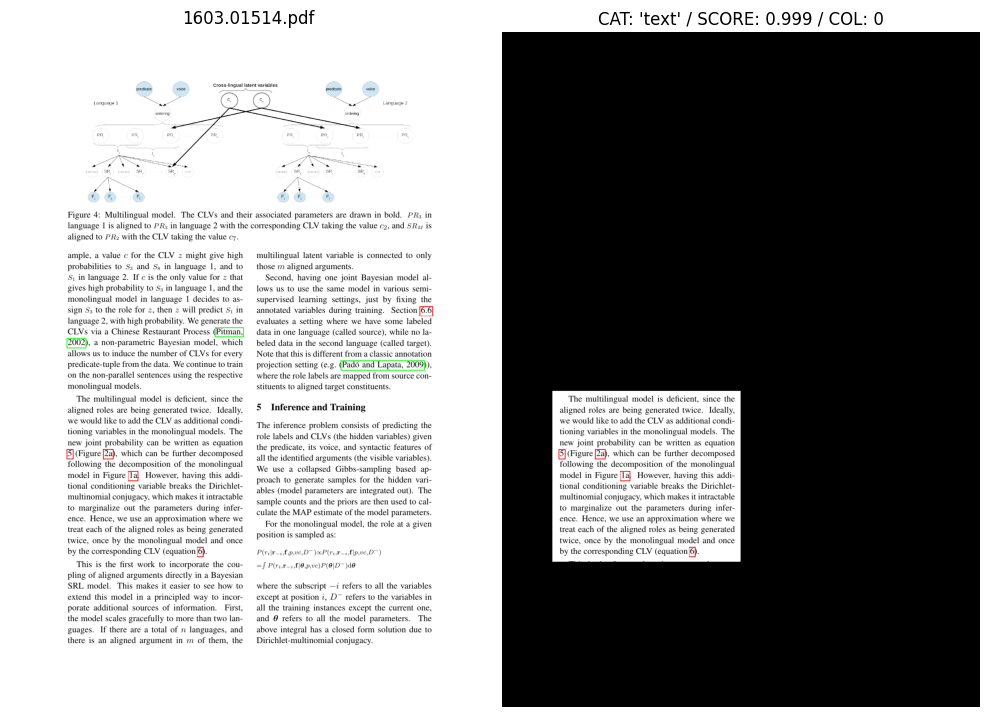

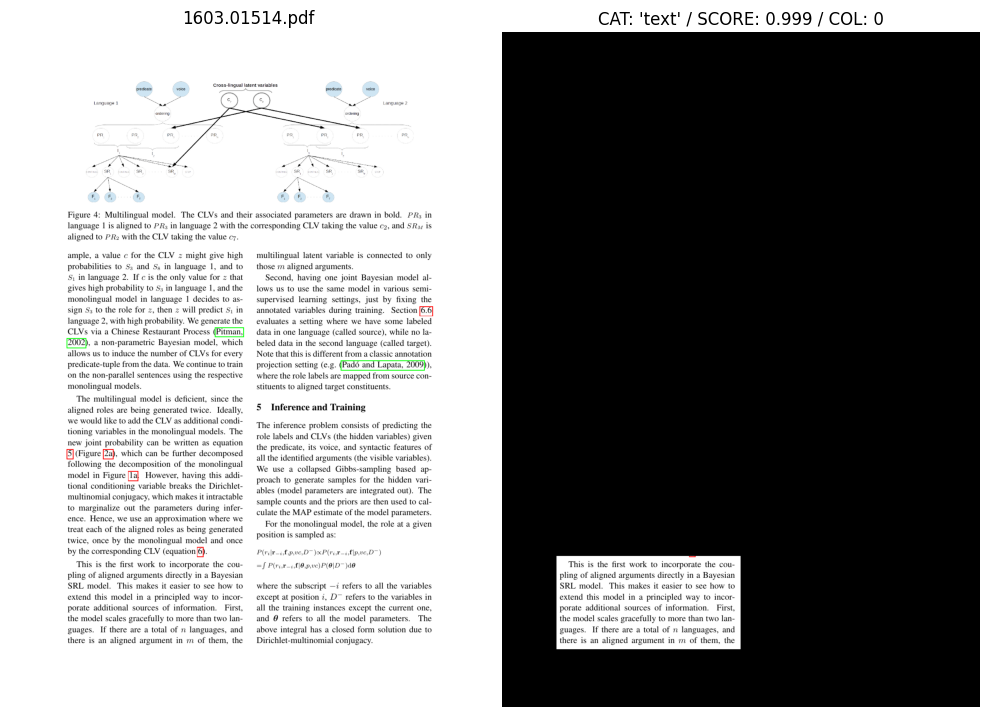

...

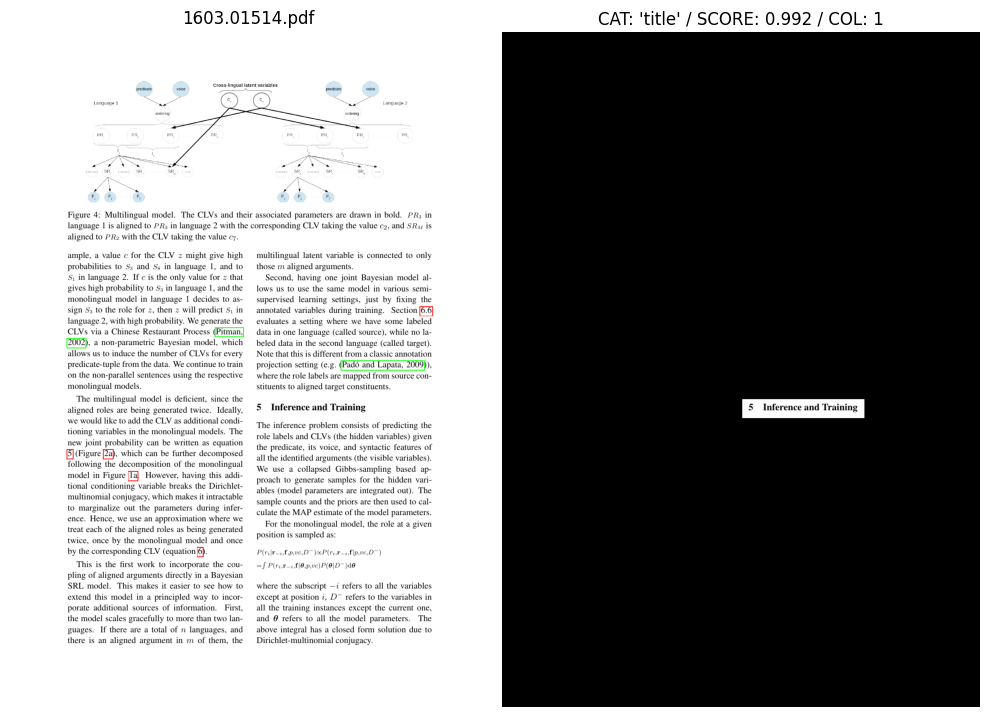

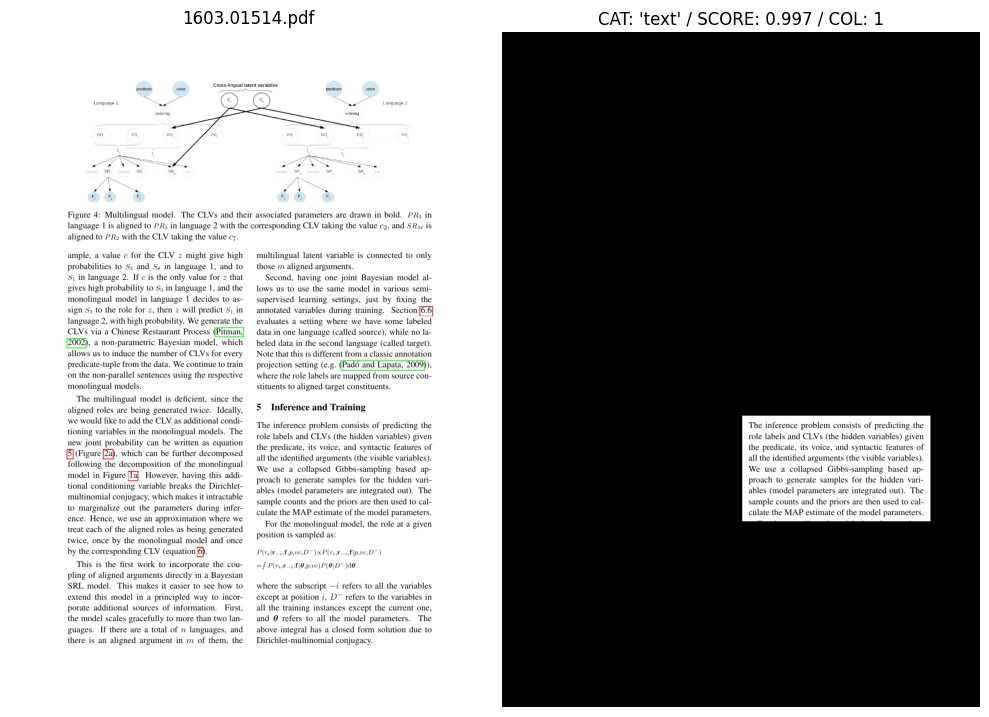

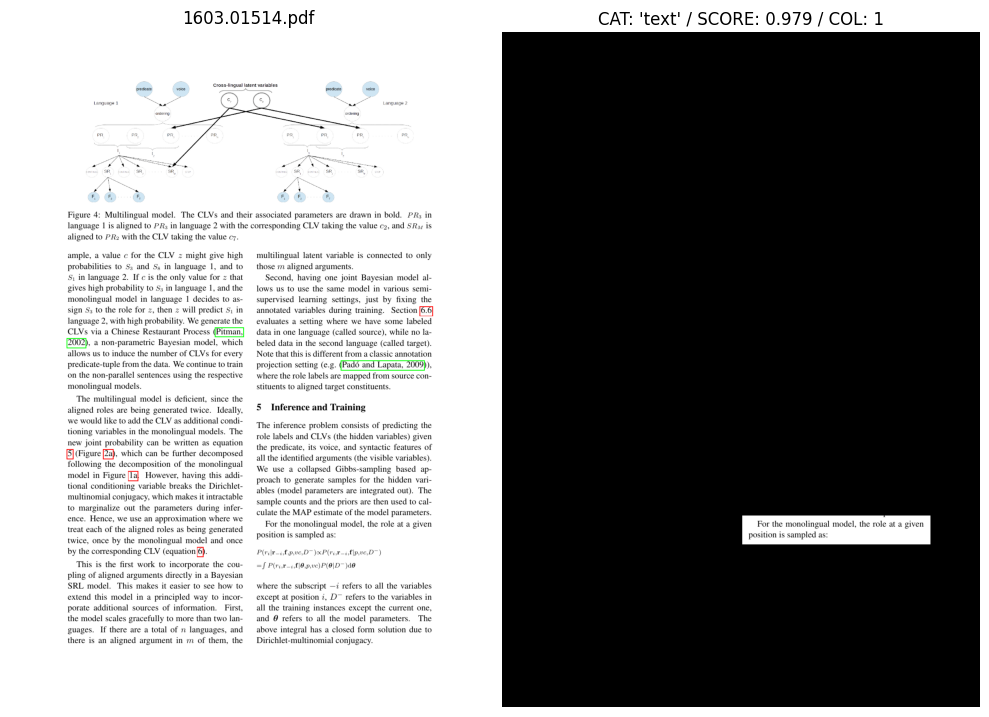

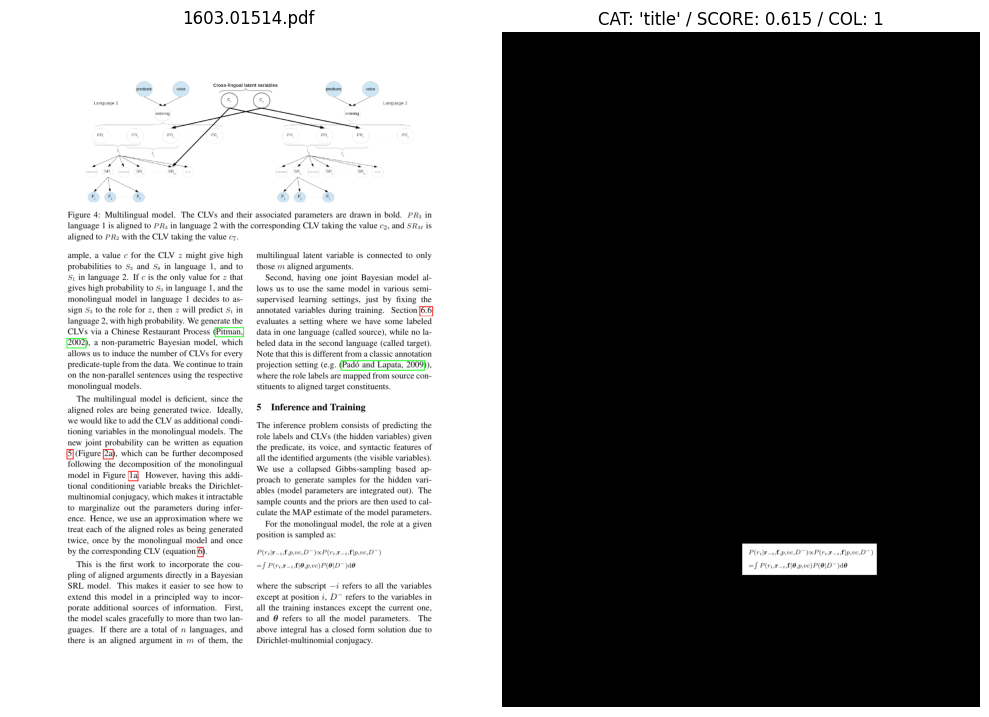

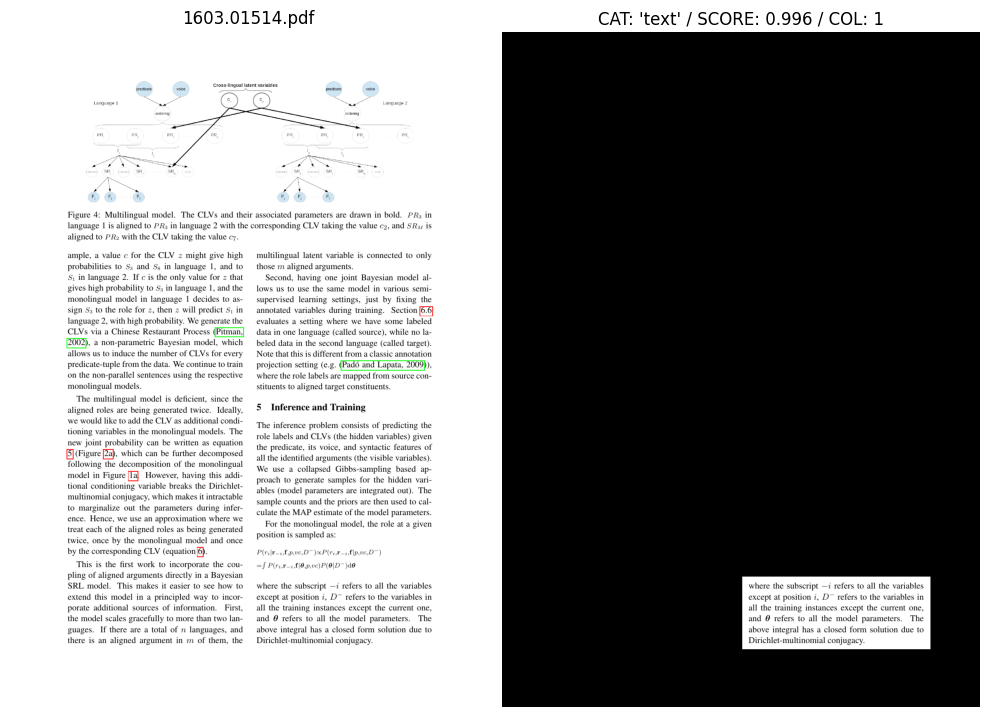

In [14]:
for i in range(len(doc_registry)):
    row = doc_registry.iloc[i, :]

    x0 = row["x0"]
    x1 = row["x1"]
    y0 = row["y0"]
    y1 = row["y1"]
    mask_shape = row["mask_shape"]

    mask = generate_rectangular_mask(x0, x1, y0, y1, mask_shape)
    page_img = page_images[page_idx]

    # Rescaling
    new_scale = page_img.shape[0:2]
    rescaled_mask = st.resize(mask, new_scale, order=0, anti_aliasing=False)

    # Apply mask
    masked_img = cv2.bitwise_and(page_img, page_img, mask=rescaled_mask)

    # Display
    mask_title = f"CAT: '{row['category_lbl']}' / SCORE: {row['score']:0.3f} / COL: {row['column']}"
    titles = [document_file, mask_title]

    display_images_with_titles([page_img, masked_img], titles)

### Directly apply a RESCALED and CROPPED rectangular mask based on the image corners

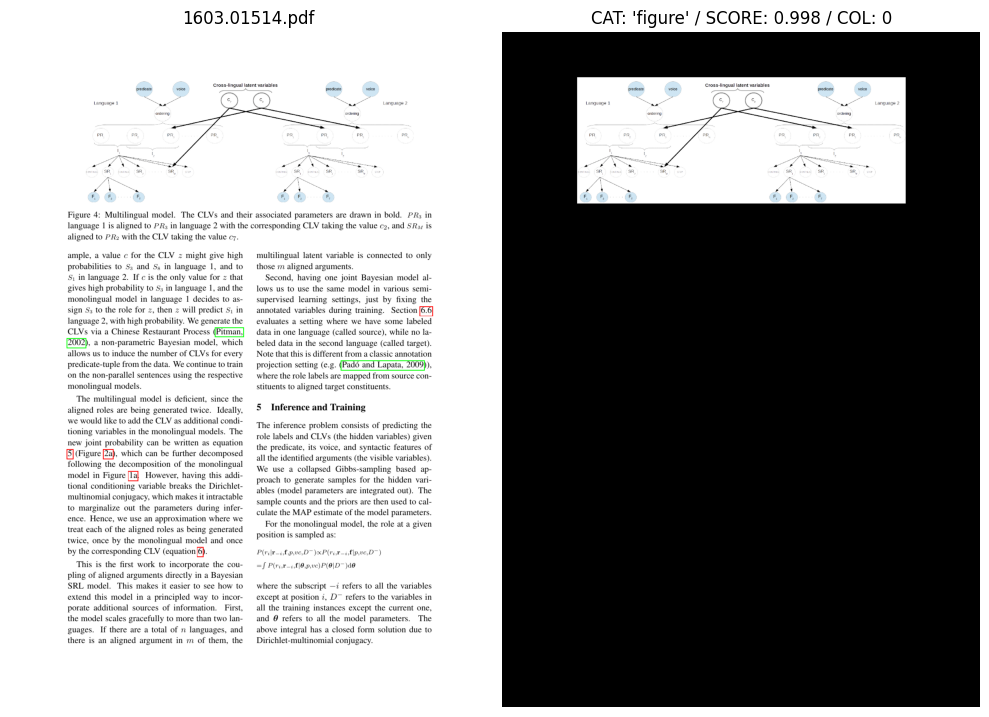

CAT: 'figure' / SCORE: 0.998 / COL: 0


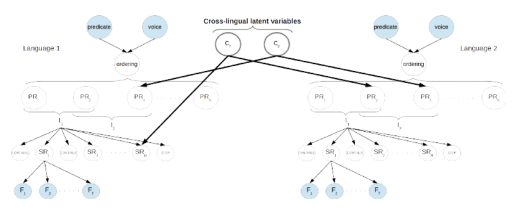

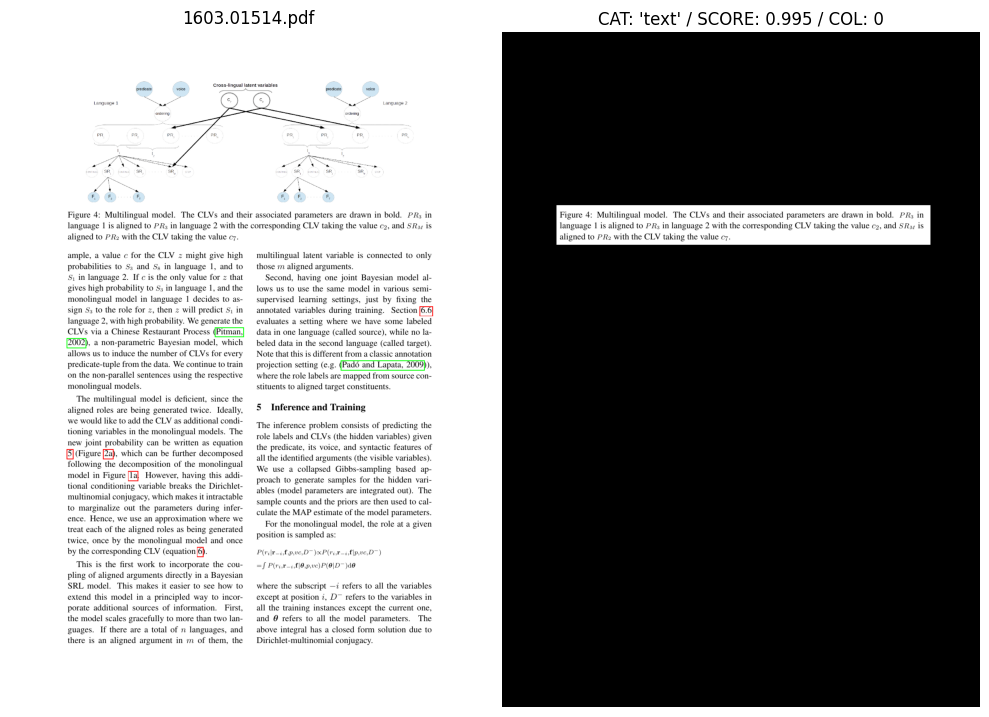

CAT: 'text' / SCORE: 0.995 / COL: 0


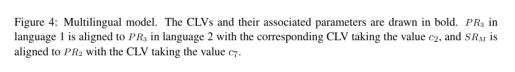

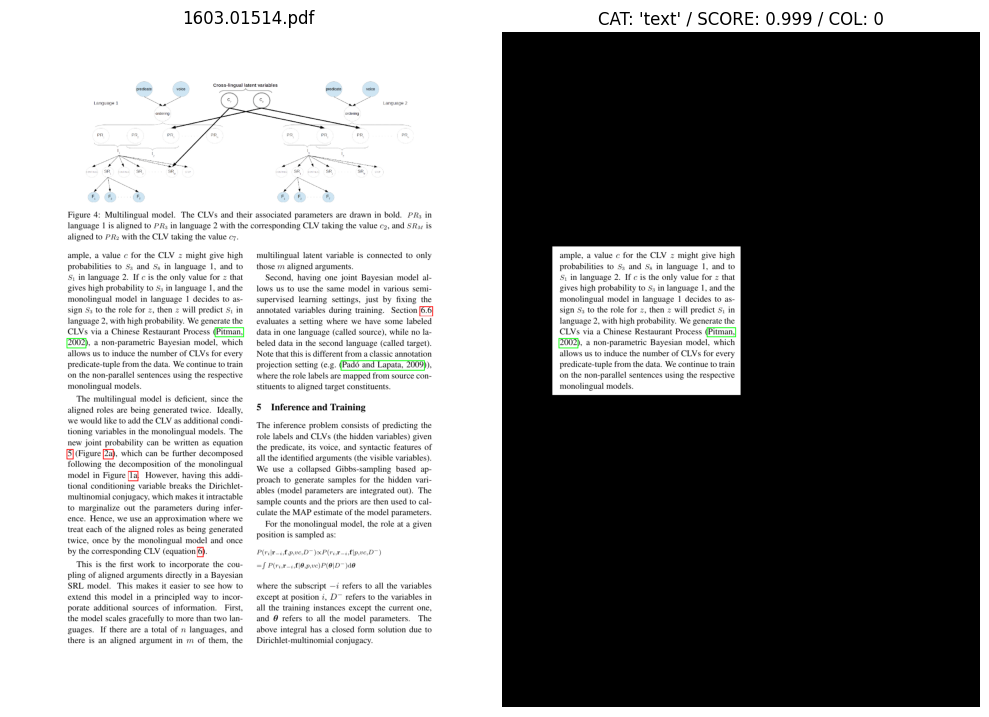

CAT: 'text' / SCORE: 0.999 / COL: 0


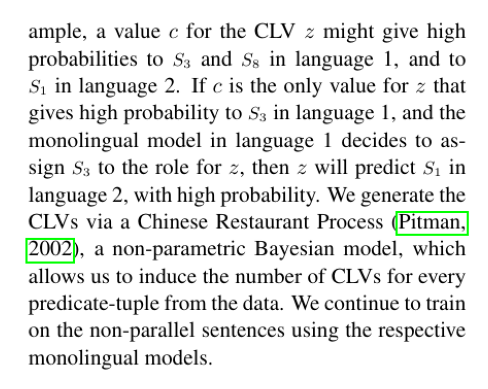

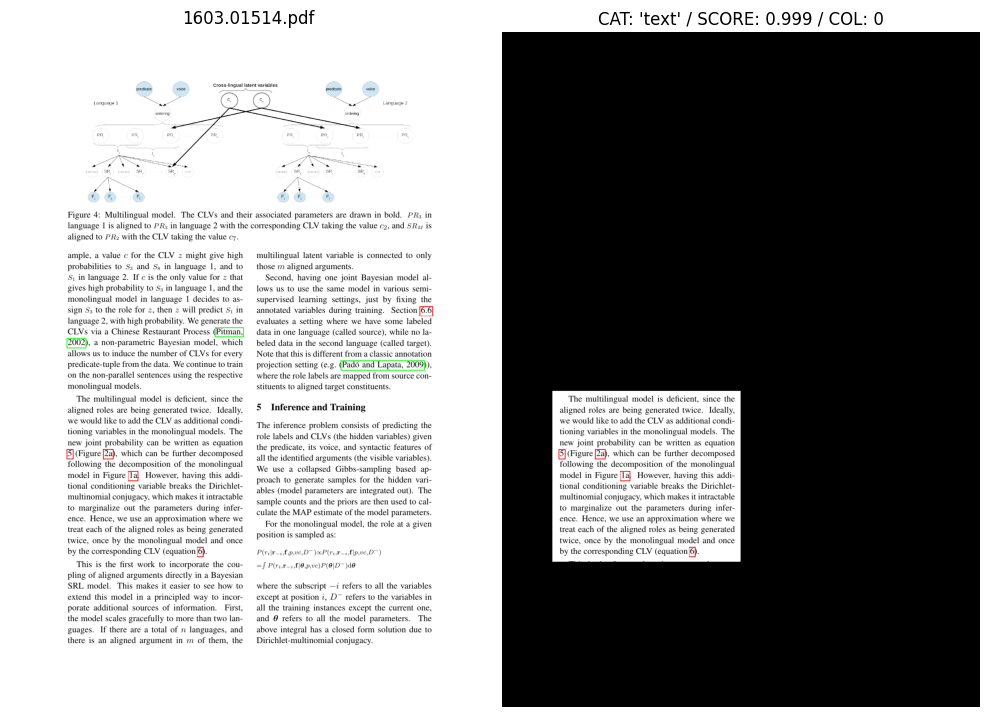

CAT: 'text' / SCORE: 0.999 / COL: 0


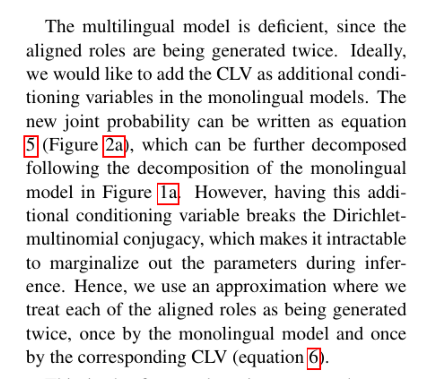

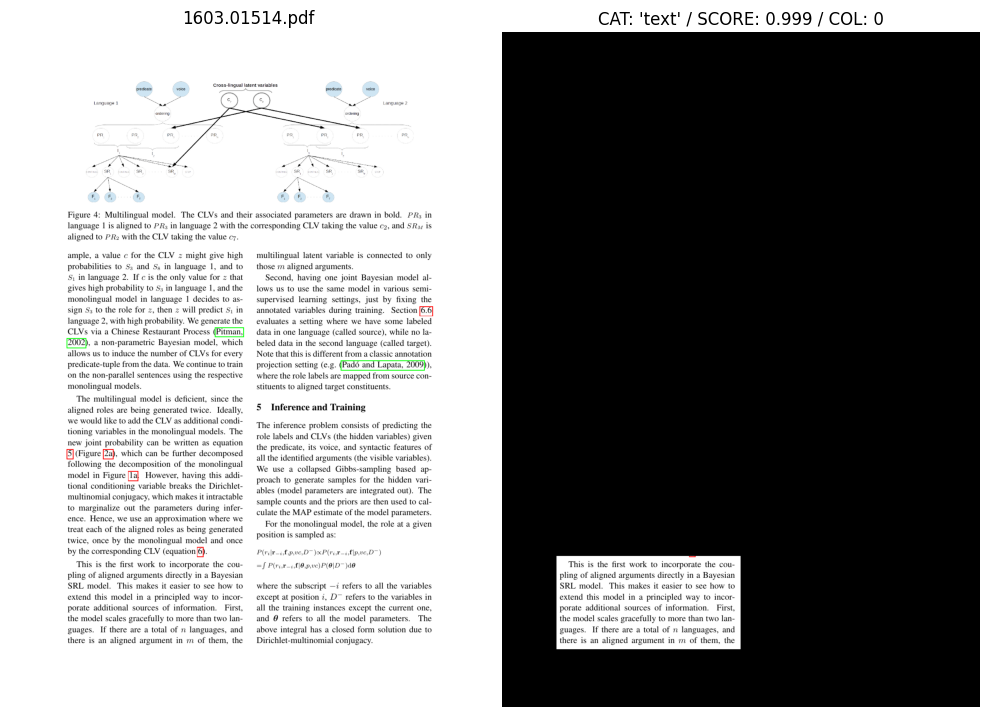

CAT: 'text' / SCORE: 0.999 / COL: 0


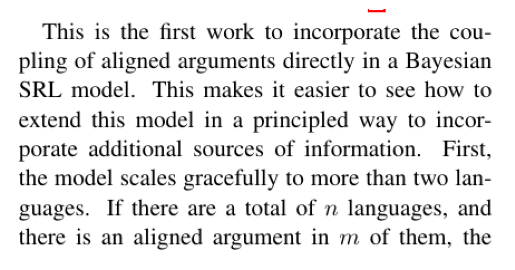

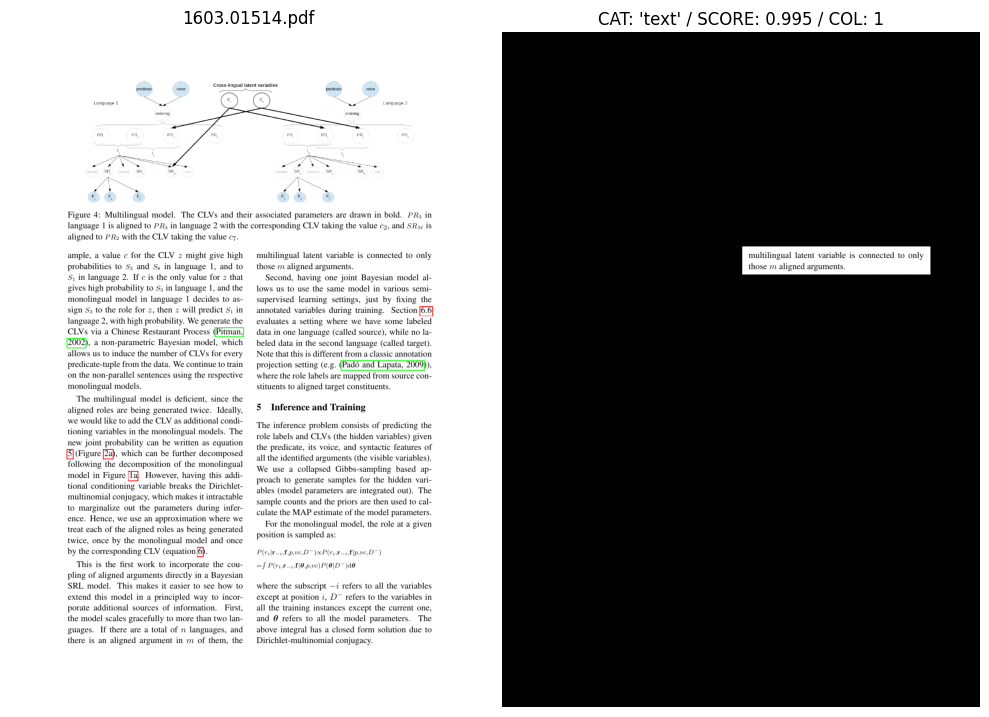

CAT: 'text' / SCORE: 0.995 / COL: 1


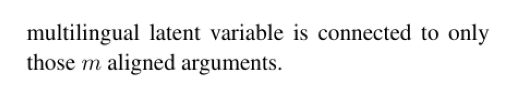

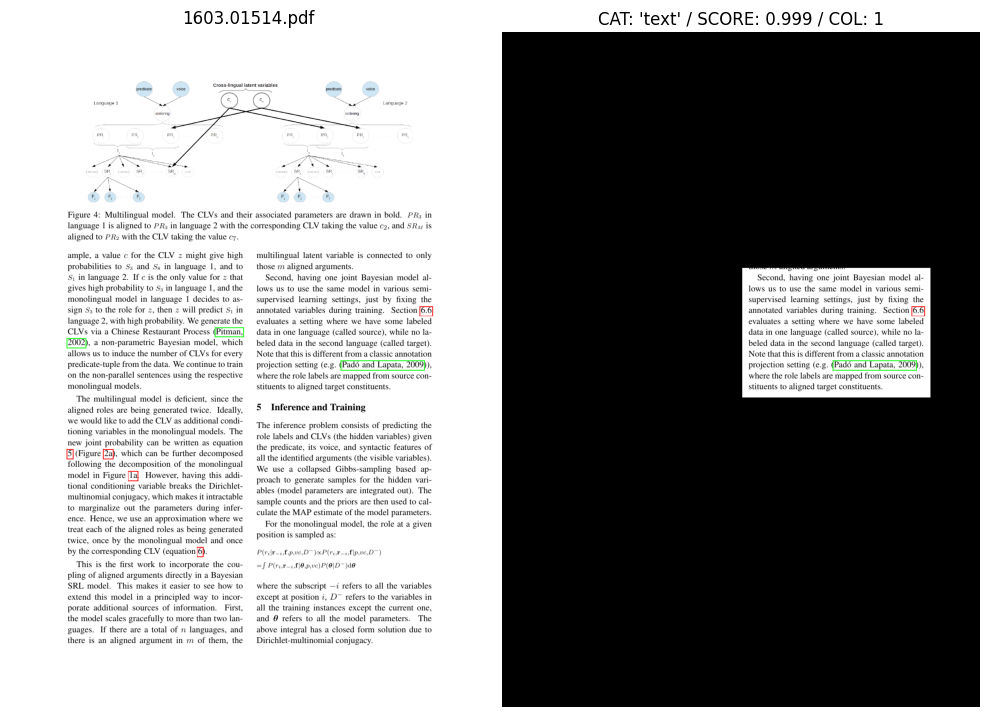

CAT: 'text' / SCORE: 0.999 / COL: 1


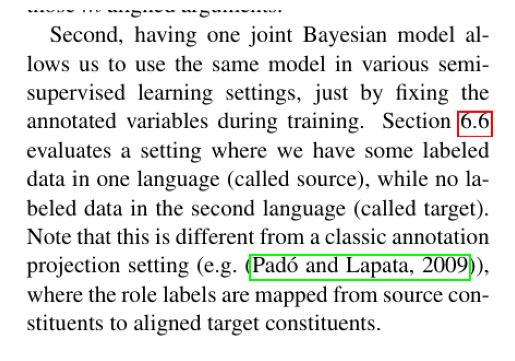

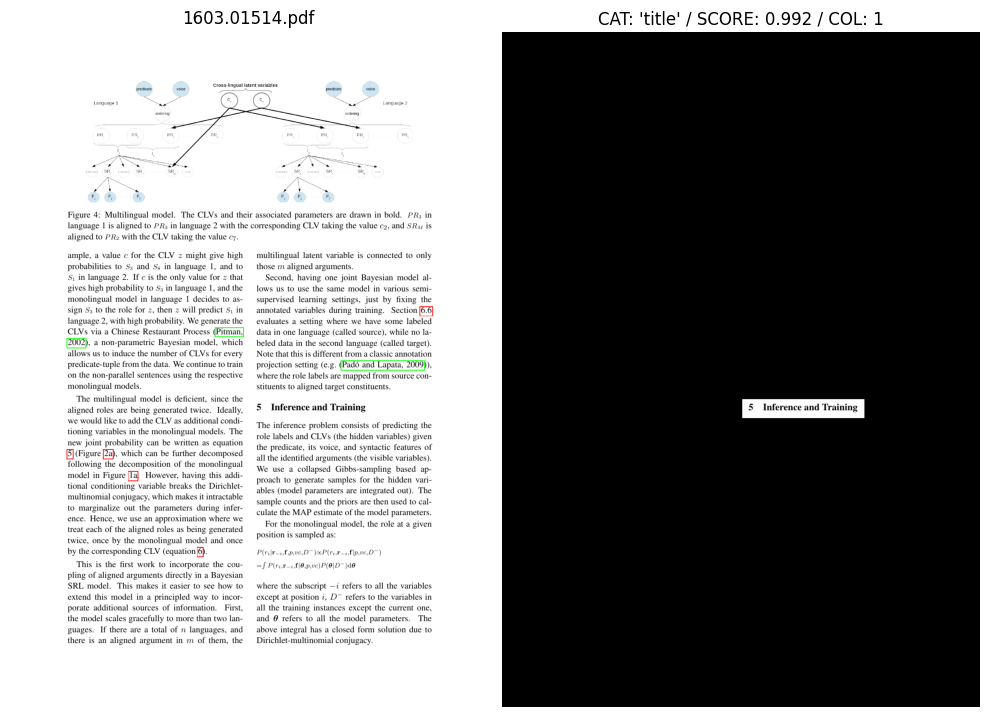

CAT: 'title' / SCORE: 0.992 / COL: 1


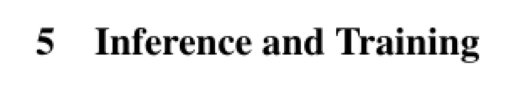

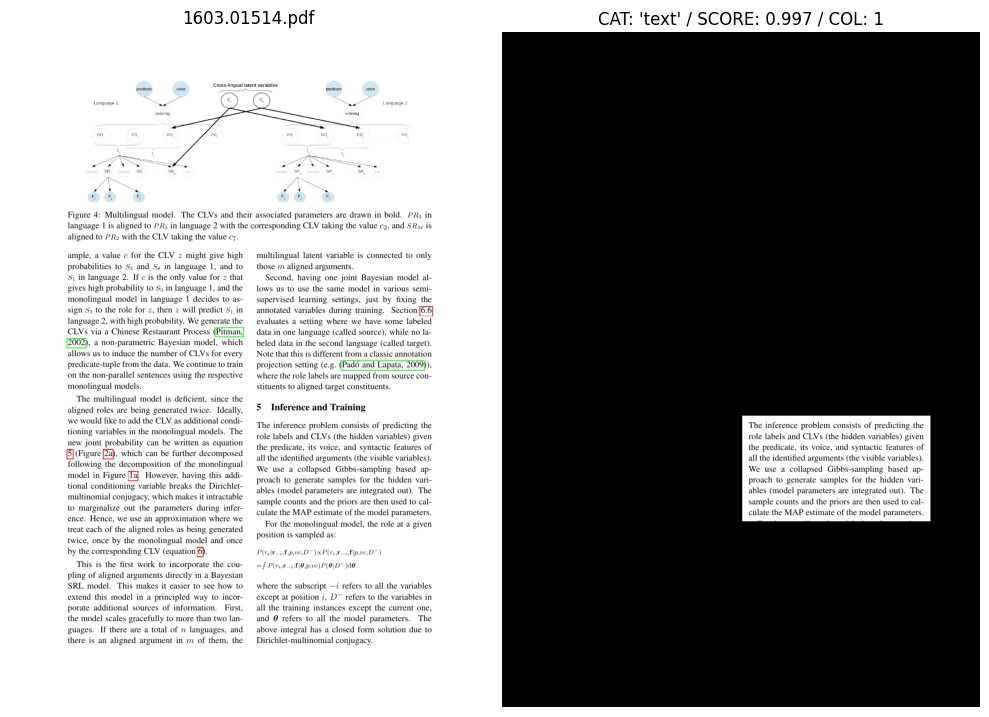

CAT: 'text' / SCORE: 0.997 / COL: 1


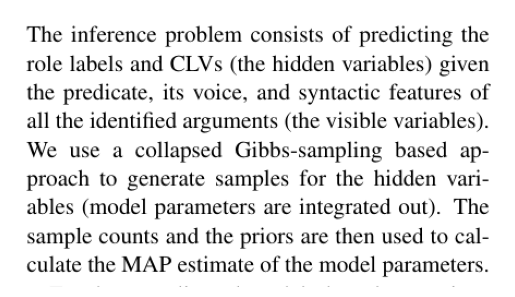

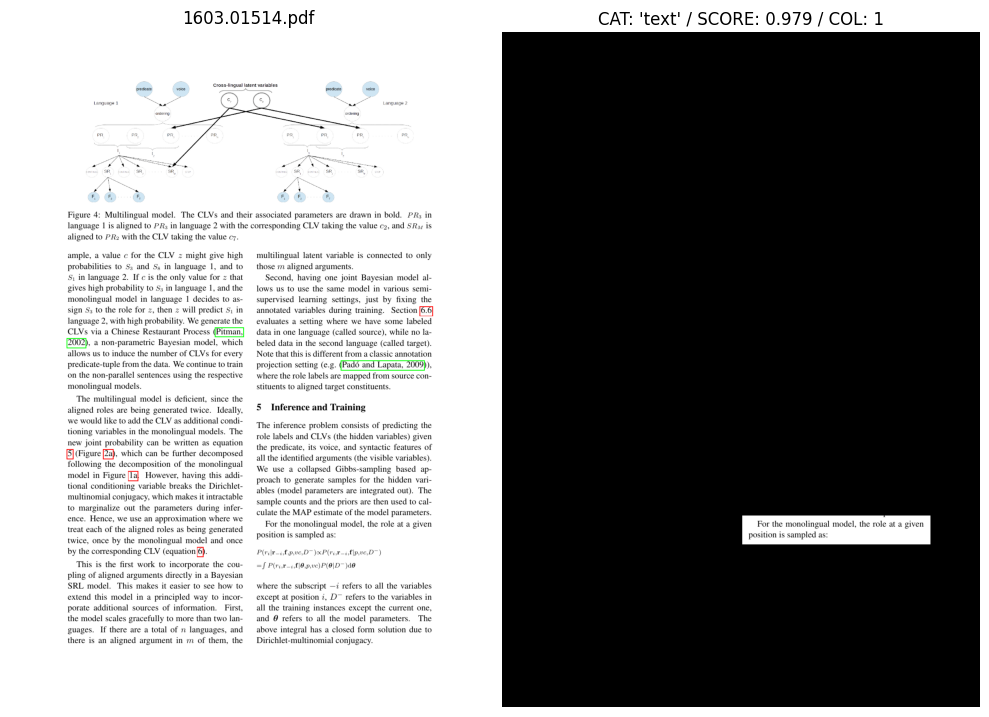

CAT: 'text' / SCORE: 0.979 / COL: 1


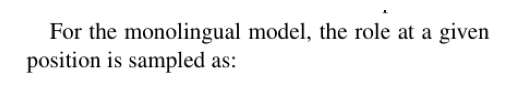

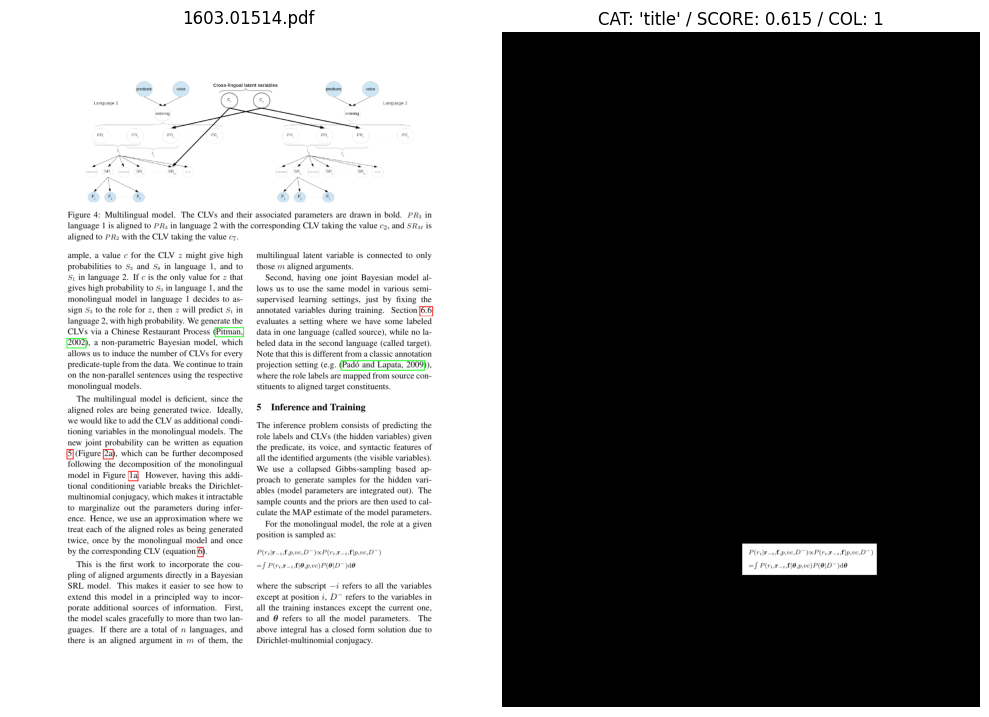

CAT: 'title' / SCORE: 0.615 / COL: 1


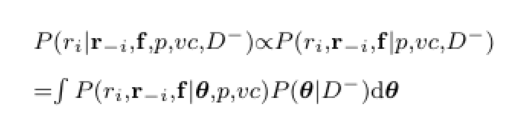

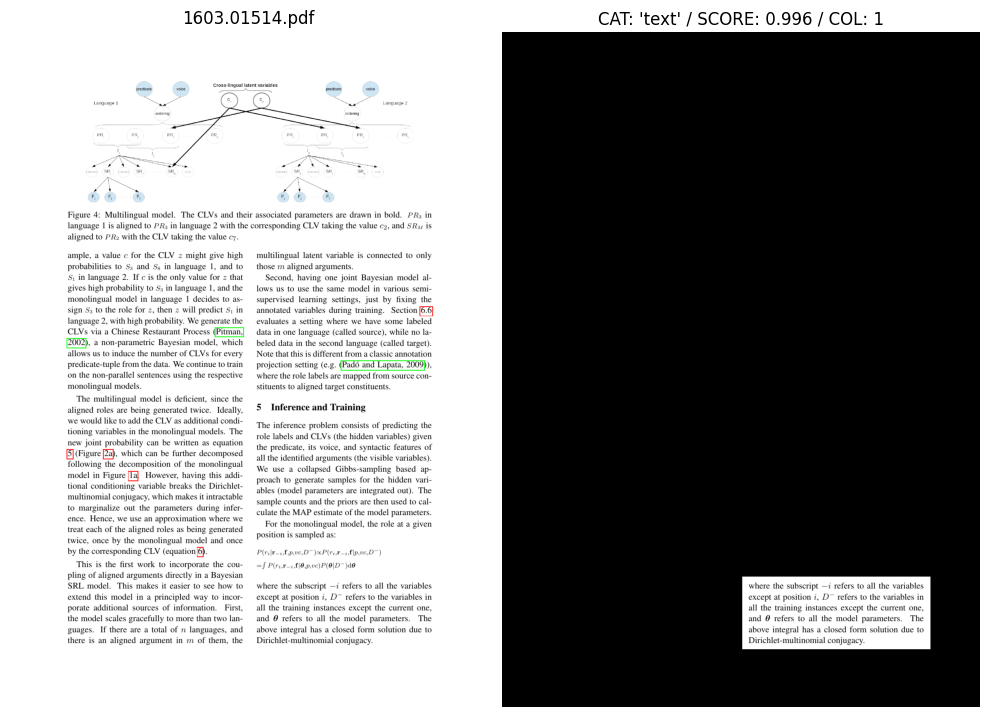

CAT: 'text' / SCORE: 0.996 / COL: 1


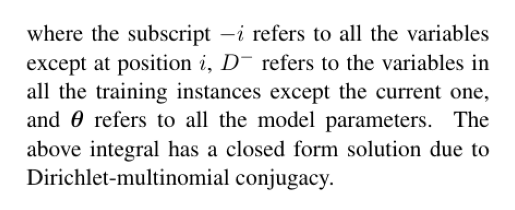

In [15]:
for i in range(len(doc_registry)):
    row = doc_registry.iloc[i, :]

    x0 = row["x0"]
    x1 = row["x1"]
    y0 = row["y0"]
    y1 = row["y1"]
    mask_shape = row["mask_shape"]

    mask = generate_rectangular_mask(x0, x1, y0, y1, mask_shape)
    page_img = page_images[page_idx]

    # Rescaling
    new_scale = page_img.shape[0:2]
    rescaled_mask = st.resize(mask, new_scale, order=0, anti_aliasing=False)

    # new bounding box edges
    x0r, x1r, y0r, y1r = get_mask_bounding_box(mask=rescaled_mask, box_buffer=0)

    # Apply mask
    masked_img = cv2.bitwise_and(page_img, page_img, mask=rescaled_mask)
    cropped_img = masked_img[y0r:y1r, x0r:x1r, :]

    # Display
    mask_title = f"CAT: '{row['category_lbl']}' / SCORE: {row['score']:0.3f} / COL: {row['column']}"
    titles = [document_file, mask_title]
    display_images_with_titles([page_img, masked_img], titles)

    # Display cropped image
    print(mask_title)
    plt.axis("off")
    plt.imshow(cropped_img)
    plt.show()